In [175]:
import math
import numpy as np
from scipy import interpolate
import cv2
import random
from matplotlib import pyplot as plt
%matplotlib inline

In [182]:
sigma = 2.75
alpha = 3.5
eps = 0.01
sigmaSq = sigma*sigma
mutations = 32*256*256
checkpoints = 1000

In [183]:
def draw_ellipse(
        img, center, axes, angle,
        startAngle, endAngle, color,
        thickness=1, lineType=cv2.LINE_AA, shift=10):
    center = (
        int(round(center[0] * 2**shift)),
        int(round(center[1] * 2**shift))
    )
    axes = (
        int(round(axes[0] * 2**shift)),
        int(round(axes[1] * 2**shift))
    )
    startAngle = int(round(startAngle* 2**shift))
    cv2.ellipse(
        img, center, axes, angle,
        startAngle, endAngle, color,
        thickness, lineType, shift)

In [184]:
img_1 = cv2.imread('lena.jpg',0)
img_2 = cv2.imread('radial_gradient.png',0)


dim = 255
x = range(0,dim)
y = range(0,dim)

rad = 20.0
img_3 = np.zeros((dim,dim))
for i in x:
    for j in y:
        if abs(i-j) < rad and j <245 and j>10: 
            img_3[j,i] = 255*math.exp(-rad**2/(rad**2-(i-j)**2))/(math.e)
        
img_4 = np.zeros((dim,dim))
for i in x:
    for j in y:
        if abs(np.linalg.norm(np.array([j,i]) - 0.5*np.array([dim,dim]) , ord=2) - 90 ) < rad-eps:
            img_4[j,i] = (255.0/1.0)*math.exp(-rad**2/(rad**2-(abs(np.linalg.norm(np.array([j,i]) - 0.5*np.array([dim,dim]) , ord=2)-90)**2)))/(math.e)
        if abs(np.linalg.norm(np.array([j,i]) - 0.5*np.array([dim,dim]) , ord=2) - 45 ) < rad-eps:
            img_4[j,i] = (255.0/1.0)*math.exp(-rad**2/(rad**2-(abs(np.linalg.norm(np.array([j,i]) - 0.5*np.array([dim,dim]) , ord=2)-45)**2)))/(math.e)
        if abs(np.linalg.norm(np.array([j,i]) - 0.5*np.array([dim,dim]) , ord=2) - 0 ) < rad-eps:
            img_4[j,i] = (255.0/1.0)*math.exp(-rad**2/(rad**2-(abs(np.linalg.norm(np.array([j,i]) - 0.5*np.array([dim,dim]) , ord=2)-0)**2)))/(math.e)

img_2 = img_1+3.0       
img_2 = img_2+3.0
img_3 = img_3+3.0
img_4 = img_4+3.0

img_1 = img_1/img_1.max()
img_2 = img_2/img_2.max()
img_3 = img_3/img_3.max()
img_4 = img_4/img_4.max()

print('img 1 type: ' + repr(type(img_1))+' img 2 type: ' + repr(type(img_2)))
print('img 1 size: ' + repr(img_1.shape)+' img 2 size: ' + repr(img_2.shape))
print('img 1 max value: ' + repr(img_1.max())+' img 2 max value: ' + repr(img_2.max()))
print('img 1 min value: ' + repr(img_1.min())+' img 2 min value: ' + repr(img_2.min()))

img 1 type: <class 'numpy.ndarray'> img 2 type: <class 'numpy.ndarray'>
img 1 size: (256, 256) img 2 size: (256, 256)
img 1 max value: 1.0 img 2 max value: 1.0
img 1 min value: 0.012605042016806723 img 2 min value: 0.036885245901639344


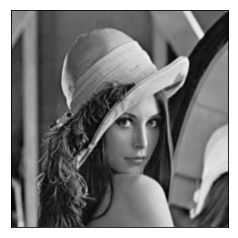

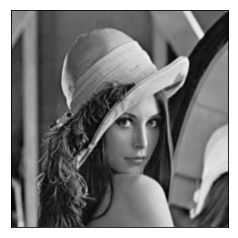

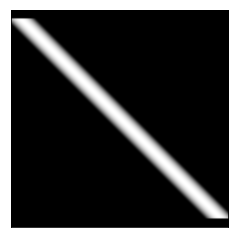

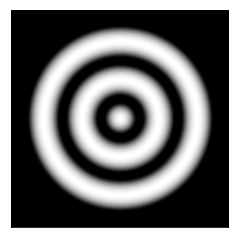

In [185]:
plt.imshow(img_1, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

plt.imshow(img_2, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

plt.imshow(img_3, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

plt.imshow(img_4, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

In [186]:
class ImgDensity(object):
    def __init__(self, img):
        self.img = img.T
        self.height, self.width = img.shape[:2]
        self.dx = 1.0
        self.dy = 1.0
        self.x = np.arange(self.width)
        self.y = np.arange(self.height)
        self.xx, self.yy = np.meshgrid(self.x, self.y)
        self.z = self.img[self.xx, self.yy]
        self.f = interpolate.interp2d(self.x, self.y, self.z, kind='linear')
        
    def getDensity(self,xp,yp):
        return self.f(xp,yp)
    
    def getLogDensity(self,xp,yp):
        return math.log(self.getDensity(xp,yp))
    
    def getGradLogDensity(self,xp,yp):
        #return np.gradient(self.getLogDensity(xp,yp))
        return 0.5*np.array([(self.getLogDensity(xp+self.dx,yp)-self.getLogDensity(xp-self.dx,yp))/self.dx,
                             (self.getLogDensity(xp,yp+self.dy)-self.getLogDensity(xp,yp-self.dy))/self.dy])
    
    def getHessLogDensity(self,xp,yp):
        #return hessian(self.getLogDensity(xp,yp))
        return 0.5*np.array([[(self.getGradLogDensity(xp+self.dx,yp)[0]-self.getGradLogDensity(xp-self.dx,yp)[0])/self.dx,
                             (self.getGradLogDensity(xp,yp+self.dy)[0]-self.getGradLogDensity(xp,yp-self.dy)[0])/self.dy],
                            [(self.getGradLogDensity(xp+self.dx,yp)[1]-self.getGradLogDensity(xp-self.dx,yp)[1])/self.dy,
                             (self.getGradLogDensity(xp,yp+self.dy)[1]-self.getGradLogDensity(xp,yp-self.dy)[1])/self.dx]])
    
    
    def getPreLogDensity(self,xp,yp):
        hess = self.getHessLogDensity(xp,yp);
        if np.linalg.norm(hess, ord=2) < 0.5/sigmaSq:
            return np.identity(2)
        
        eigenValues, eigenVector = np.linalg.eig(-hess)
        eigenBuff = eigenValues;
        for i in range(2):
            eigenBuff[i] = math.tanh(alpha*eigenValues[i])/eigenValues[i] if abs(eigenValues[i]) > eps else alpha
            #eigenBuff[i] = 1.0/(abs(eigenValues[i])+0.01)
            
        return np.matmul(np.matmul(eigenVector, np.diag(eigenBuff)), eigenVector.T)

    
    def logProposalDensity(self, x0, x1, y0, y1):
        gradient = self.getGradLogDensity(x0, x1)
        preCond = self.getPreLogDensity(x0, x1)
        
        return -np.linalg.norm(np.array([y0,y1])-np.array([x0,x1])-0.5*sigmaSq * np.matmul(preCond,gradient.T), ord=2)**2 / (2 * sigmaSq)
        

In [187]:
class MultivariateNormal(object):
    def __init__(self, mean, cov):
        self.mean = mean
        self.cov = cov
        self.eigenValue, self.eigenVector = np.linalg.eig(self.cov)
        self.scale = np.multiply(np.abs(self.eigenValue), np.array([np.linalg.norm(self.eigenVector[0,:], ord=2), 
                                                           np.linalg.norm(self.eigenVector[0,:], ord=2)]))
        self.angle = math.degrees(math.atan2(-self.eigenVector[0,1], self.eigenVector[0,0]))
        self.dim = mean.size
        
    def getSample(self, width, height):
        return np.random.multivariate_normal(self.mean, self.cov)
    

In [188]:
def makeHistogram(img):
    
    imgDens = ImgDensity(img)
    histogram = np.zeros((imgDens.height, imgDens.width))
    
    x0 = random.randint(0,imgDens.width-1)
    x1 = random.randint(0,imgDens.height-1)
    Fx = imgDens.getLogDensity(x0, x1)
    
    mean = np.array([x0, x1])+0.5*sigmaSq*np.matmul(imgDens.getPreLogDensity(x0, x1),imgDens.getGradLogDensity(x0, x1))
    cov = sigmaSq*imgDens.getPreLogDensity(x0, x1)
    gaussian = MultivariateNormal(mean, cov)
    
    
    A = 0;
    for i in range(mutations):

        y0, y1 = gaussian.getSample(imgDens.width, imgDens.height)
        
        if (y0 < 0 or y0 > imgDens.width-1 or y1 < 0 or y1 > imgDens.height-1):
            x0 = random.randint(0,imgDens.width-1)
            x1 = random.randint(0,imgDens.height-1)
            Fx = imgDens.getLogDensity(x0, x1)
            mean = np.array([x0, x1])+0.5*sigmaSq*np.matmul(imgDens.getPreLogDensity(x0, x1),imgDens.getGradLogDensity(x0, x1))
            cov = sigmaSq*imgDens.getPreLogDensity(x0, x1)
            gaussian = MultivariateNormal(mean, cov)
            continue
        
        Fy = imgDens.getLogDensity(y0, y1)
        kxy = imgDens.logProposalDensity(x0, x1, y0, y1 )
        kyx = imgDens.logProposalDensity(y0, y1, x0, x1 )
        
        Axy = min(1, math.exp((Fy + kxy) - (Fx + kyx)))
        if (random.uniform(0,1) < Axy):
            A = A + 1
            x0 = y0
            x1 = y1
            Fx=Fy
            mean = np.array([x0,x1]) + 0.5*sigmaSq*np.matmul(imgDens.getPreLogDensity(x0, x1),imgDens.getGradLogDensity(x0, x1))
            cov = sigmaSq*imgDens.getPreLogDensity(x0, x1)
            gaussian = MultivariateNormal(mean, cov)
            
            histogram[int(round(x0)),int(round(x1))] = histogram[int(round(x0)),int(round(x1))] + 1.0
            
        if (i%checkpoints) == 0:
            ARate = float(A)/float(i+1)
            print('i: ' + repr(i))
            print('acceptance rate: ' + repr(ARate))
            
            f = plt.figure(figsize=(15,15))
            ax = f.add_subplot(121)
            ax2 = f.add_subplot(122)
            
            img_temp = np.zeros((imgDens.height, imgDens.width,4))
            img_temp[:,:,3] = 1.0-histogram.T/histogram.max()
            draw_ellipse(img_temp, tuple(gaussian.mean), tuple(gaussian.scale), int(gaussian.angle), 0,360, [1,0,0,1])
            draw_ellipse(img_temp, tuple(gaussian.mean), tuple(2.0*gaussian.scale), int(gaussian.angle), 0,360, [0,1,0,1])
            cv2.circle(img_temp, (int(round(x0)),int(round(x1))), 1, [0,0,1,1],-1)
            ax.imshow(img_temp, interpolation = 'bicubic')
            plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
            
            img_temp = np.zeros((imgDens.width, imgDens.height,4))
            img_temp[:,:,3] = 1.0-img/img.max()
            draw_ellipse(img_temp, tuple(gaussian.mean), tuple(gaussian.scale), int(gaussian.angle), 0,360, [1,0,0,1])
            draw_ellipse(img_temp, tuple(gaussian.mean), tuple(2.0*gaussian.scale), int(gaussian.angle), 0,360, [0,1,0,1])
            cv2.circle(img_temp, (int(round(x0)),int(round(x1))), 1, [0,0,1,1],-1)
            ax2.imshow(img_temp, interpolation = 'bicubic')
            plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
            
            plt.show()
    
    ARate = float(A)/float(mutations)
    
    print('acceptance rate: ' + repr(ARate))
    print('histogram max value: ' + repr(histogram.max()))
    histogram =  255 * histogram / histogram.max()
    
    cv2.imwrite("MetropolisTest_Final.png" ,histogram)


i: 0
acceptance rate: 1.0


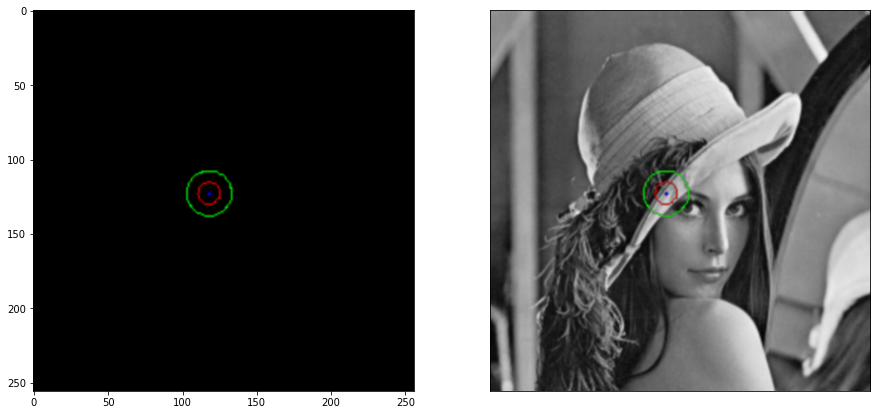

i: 1000
acceptance rate: 0.9300699300699301


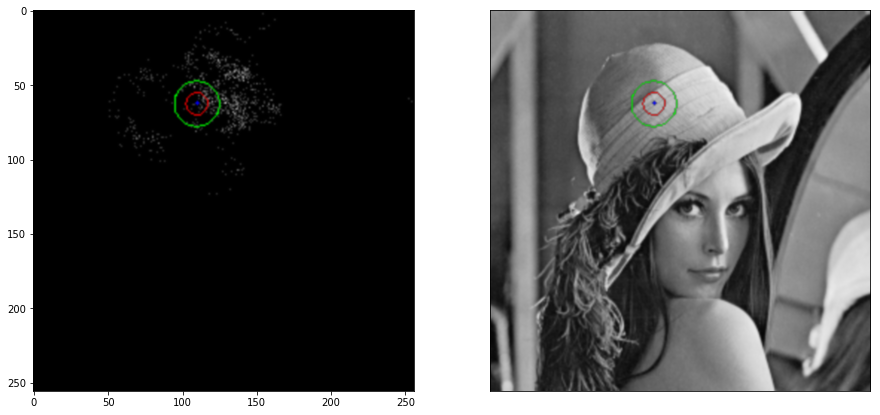

i: 2000
acceptance rate: 0.9175412293853074


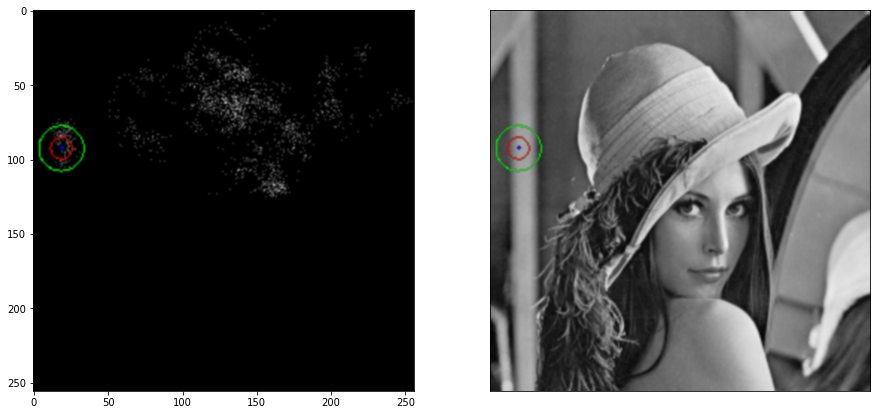

i: 3000
acceptance rate: 0.903032322559147


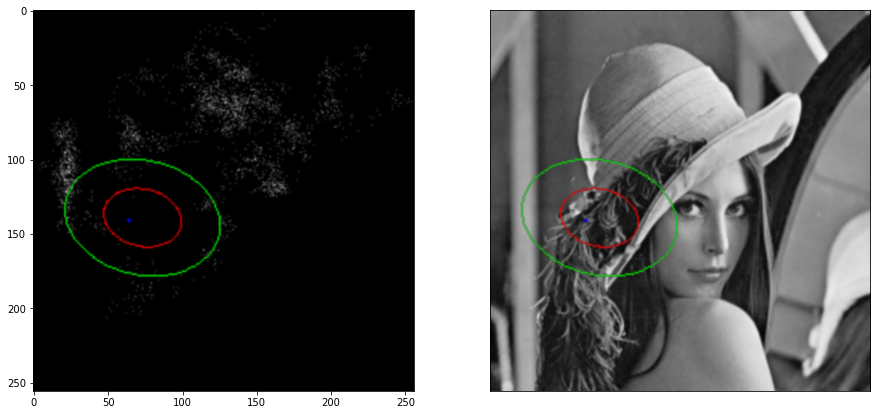

i: 4000
acceptance rate: 0.8957760559860035


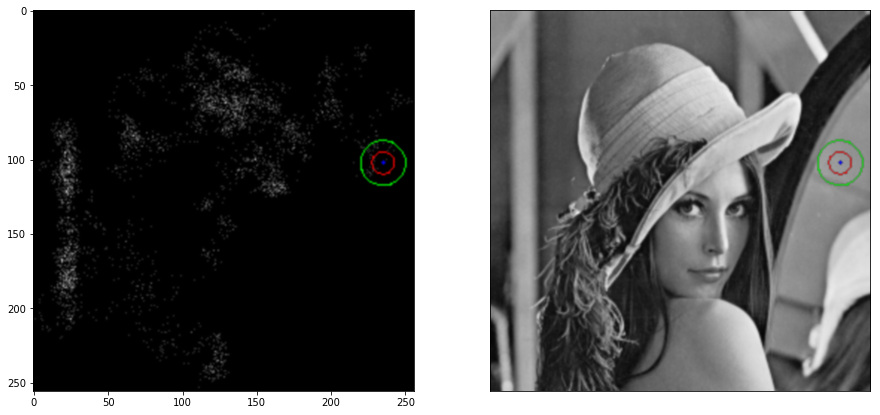

i: 5000
acceptance rate: 0.9002199560087982


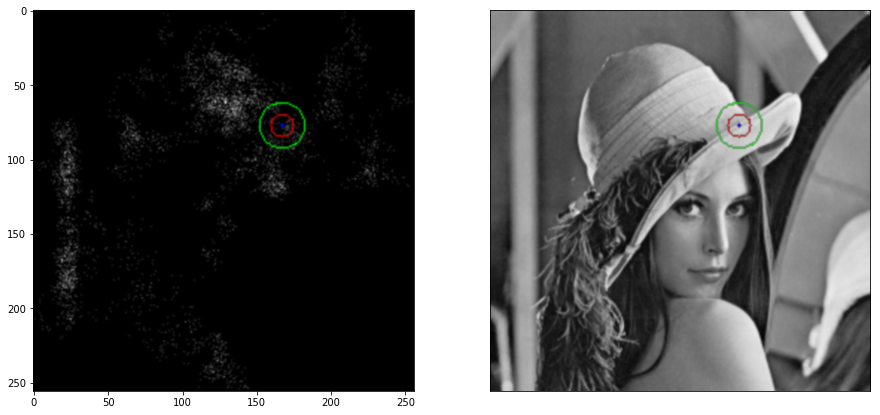

i: 6000
acceptance rate: 0.905182469588402


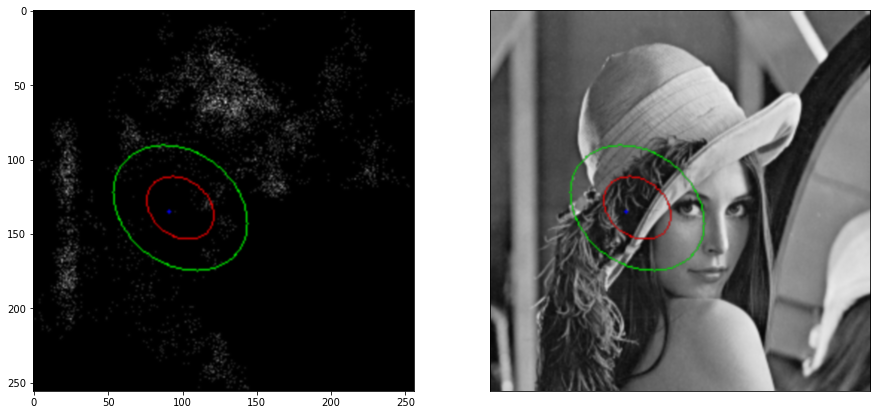

i: 7000
acceptance rate: 0.9045850592772461


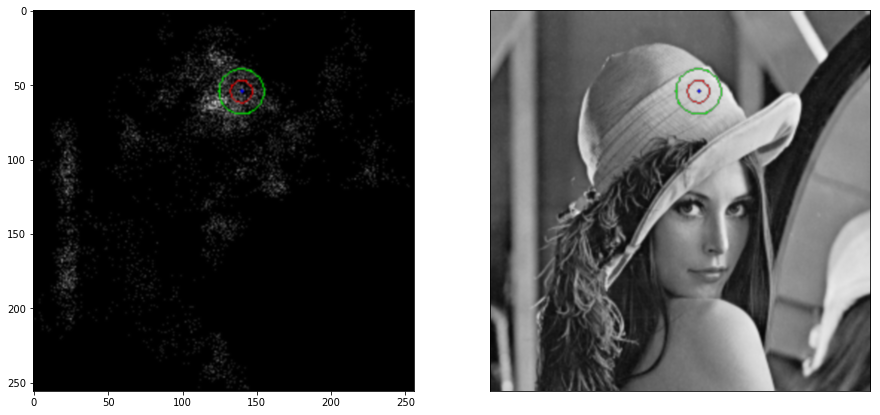

i: 8000
acceptance rate: 0.9075115610548682


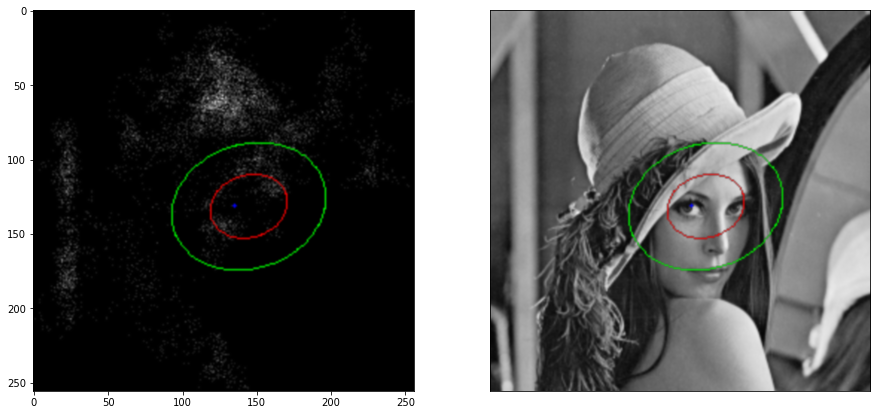

i: 9000
acceptance rate: 0.9078991223197422


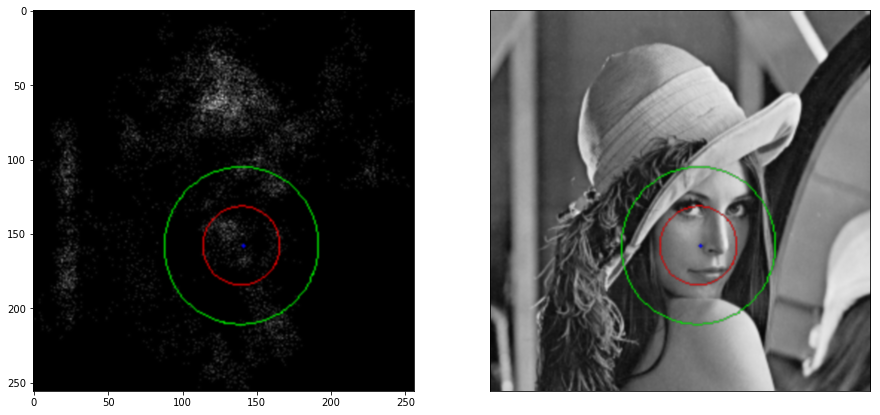

i: 10000
acceptance rate: 0.9088091190880911


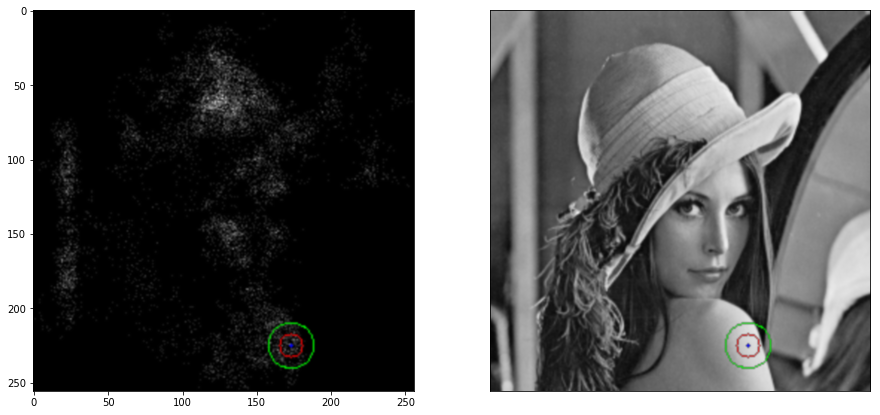

i: 11000
acceptance rate: 0.9031906190346333


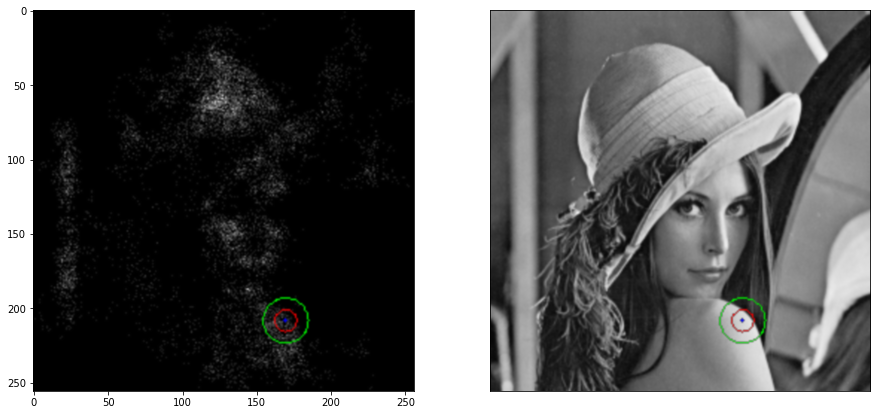

i: 12000
acceptance rate: 0.9012582284809599


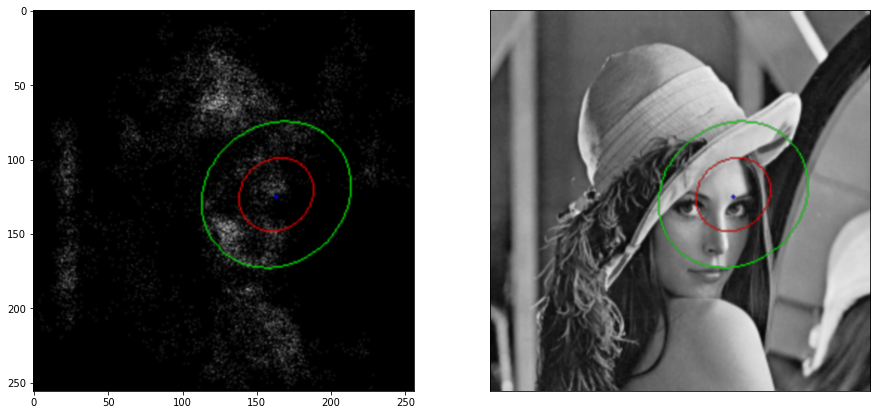

i: 13000
acceptance rate: 0.9033151296054149


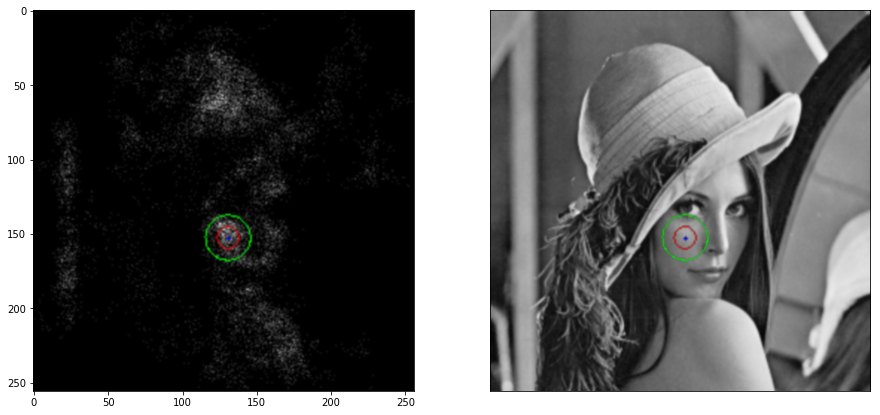

i: 14000
acceptance rate: 0.9030069280765659


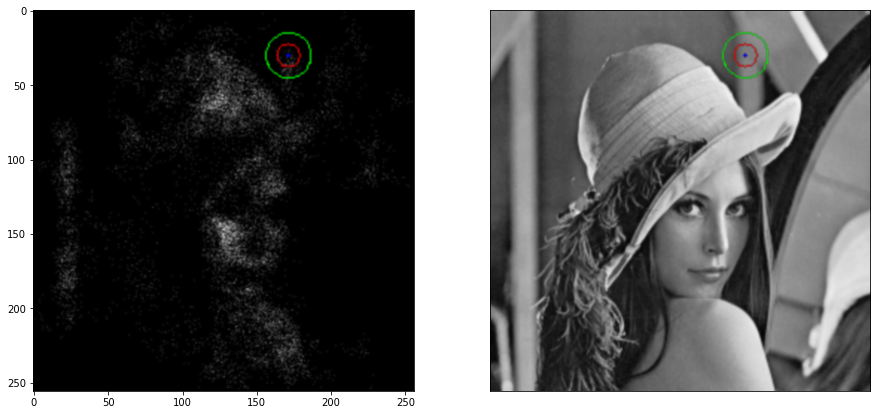

i: 15000
acceptance rate: 0.9043397106859543


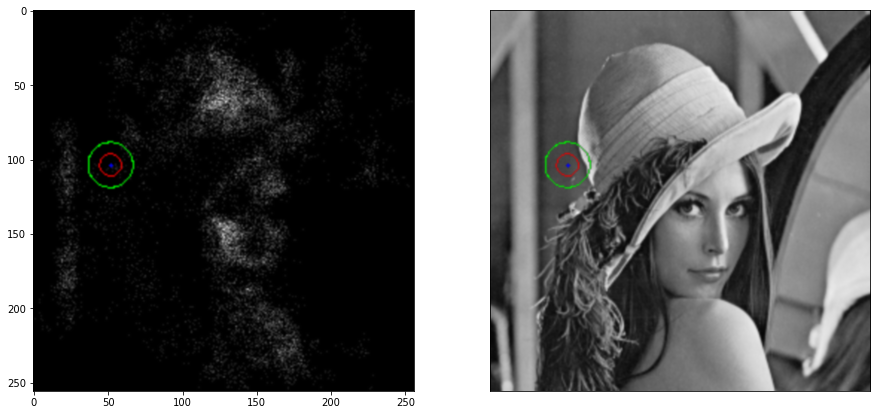

i: 16000
acceptance rate: 0.9036935191550528


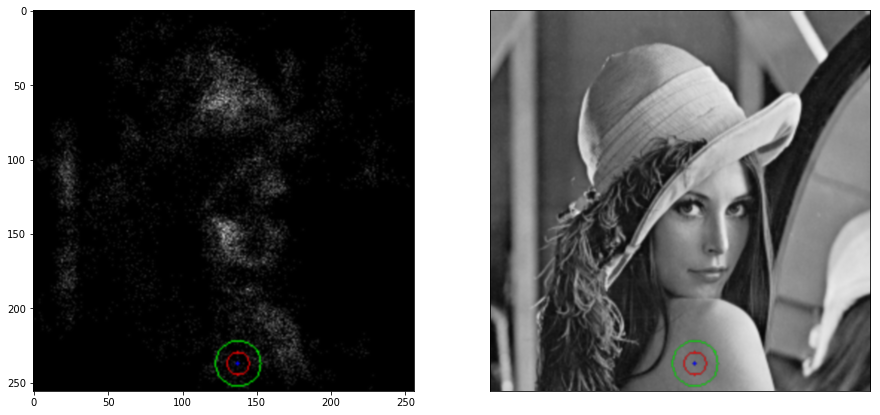

i: 17000
acceptance rate: 0.9046526674901476


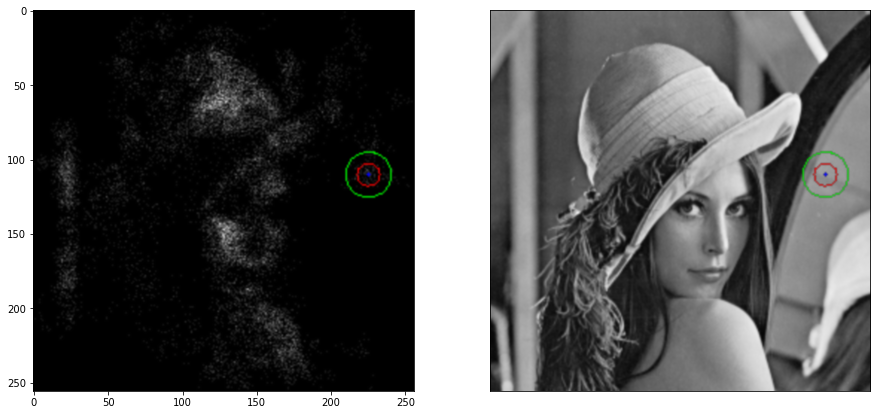

i: 18000
acceptance rate: 0.9059496694628076


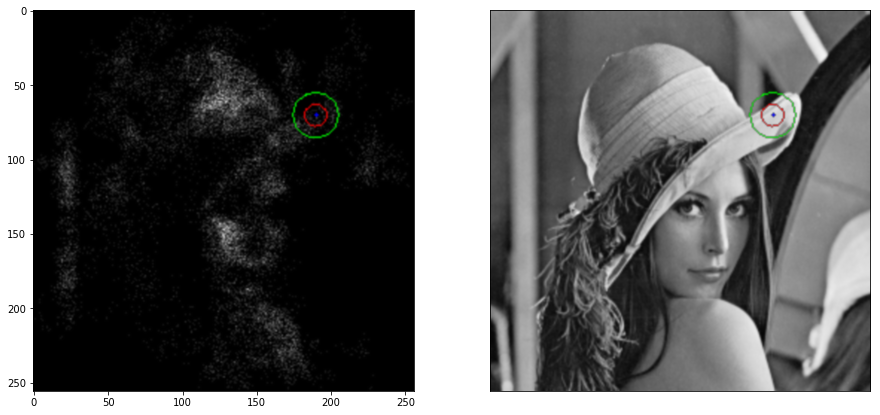

i: 19000
acceptance rate: 0.9076890689963686


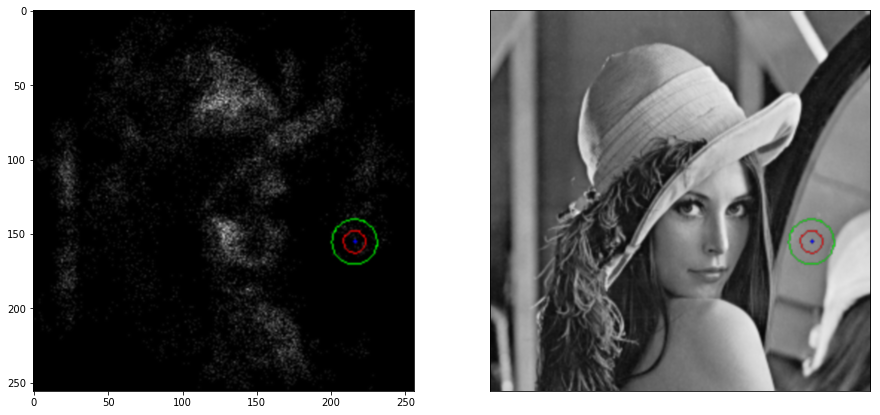

i: 20000
acceptance rate: 0.9074546272686366


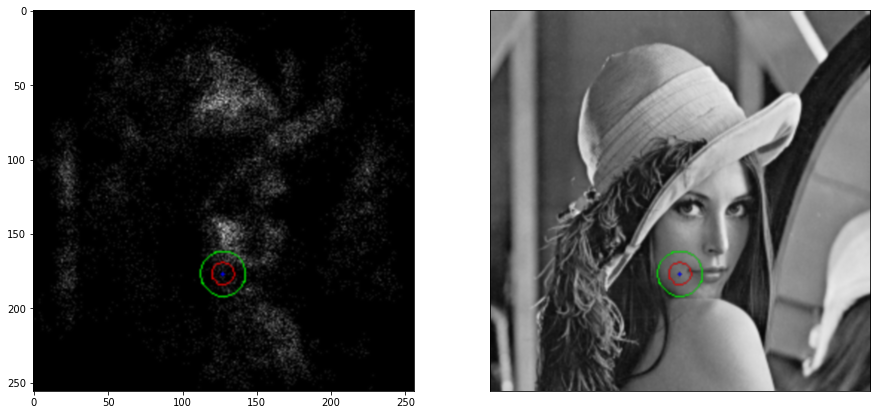

i: 21000
acceptance rate: 0.9072901290414742


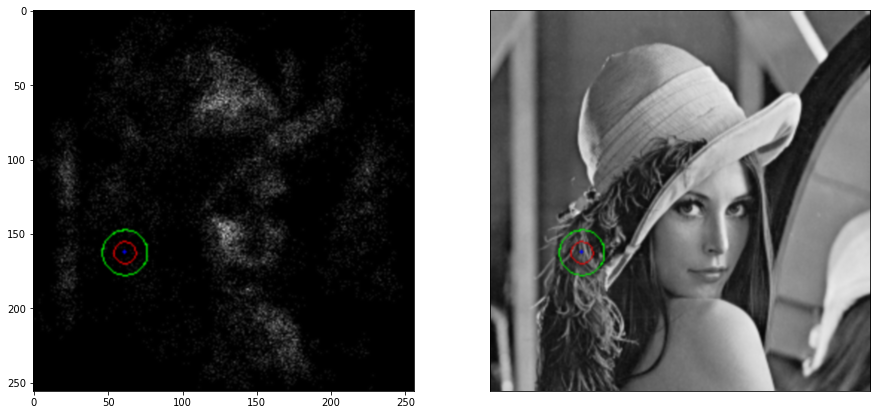

i: 22000
acceptance rate: 0.9051861279032771


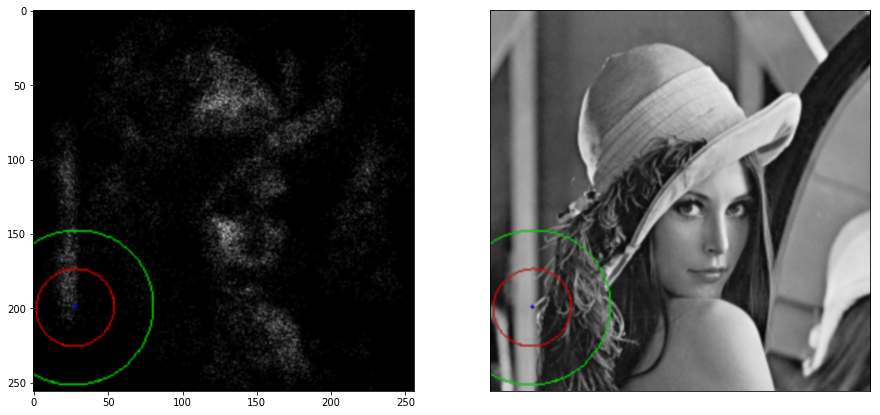

i: 23000
acceptance rate: 0.9051780357375766


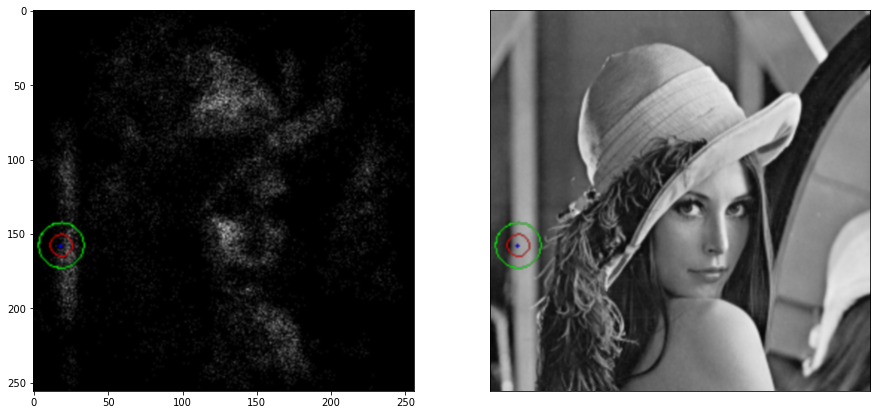

i: 24000
acceptance rate: 0.904462314070247


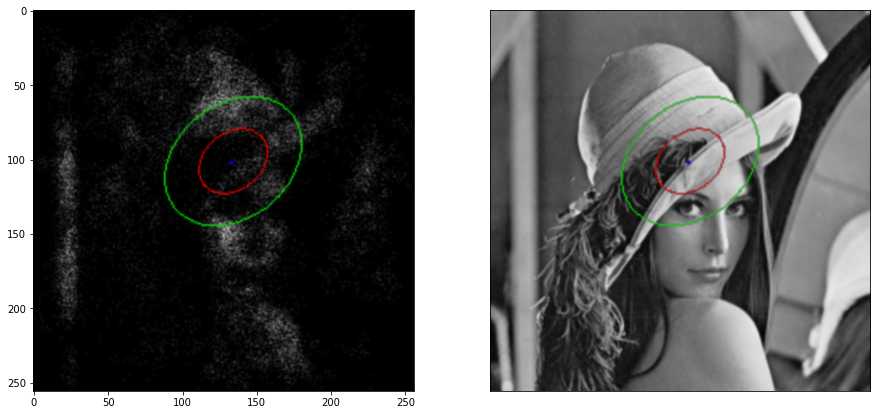

i: 25000
acceptance rate: 0.9051237950481981


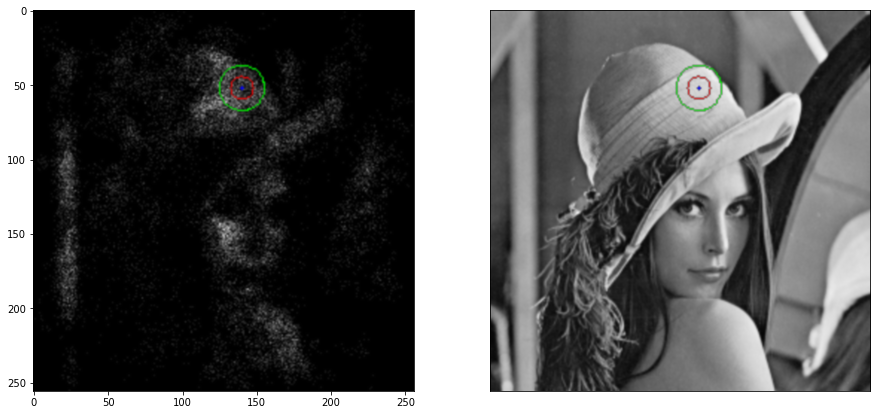

i: 26000
acceptance rate: 0.905888235067882


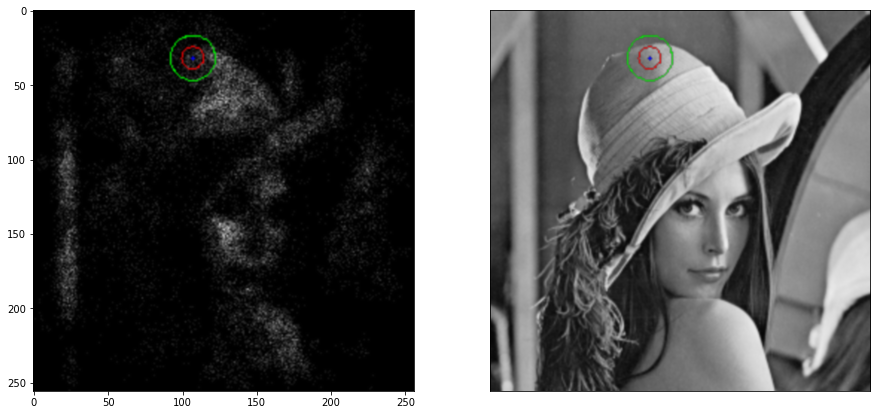

i: 27000
acceptance rate: 0.90715158697826


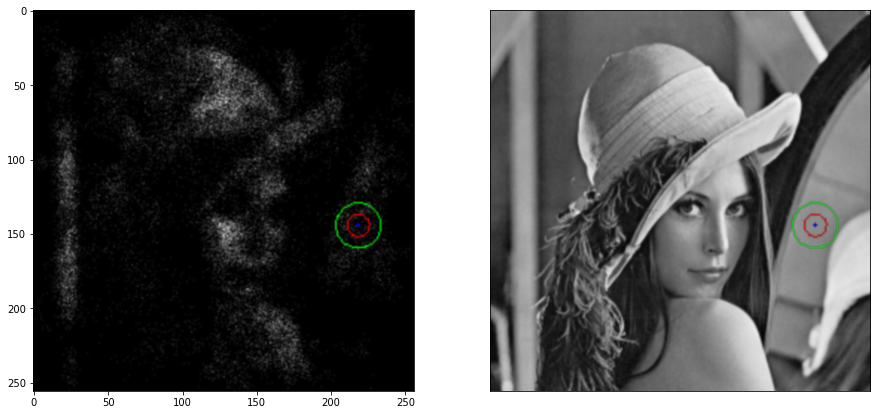

i: 28000
acceptance rate: 0.9055390878897183


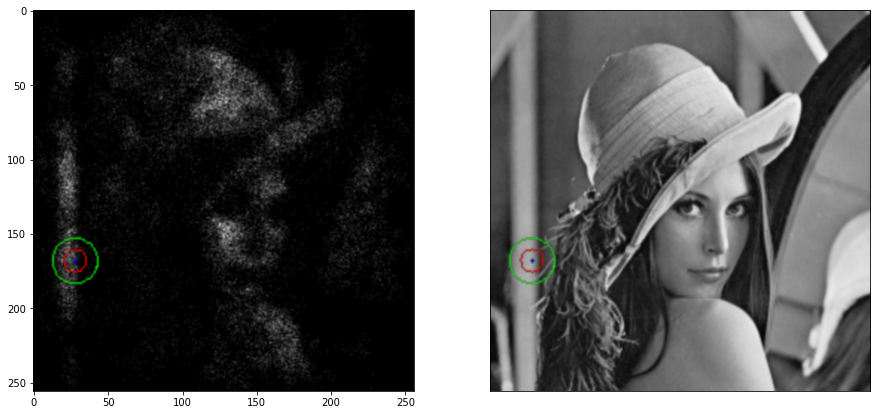

i: 29000
acceptance rate: 0.9058308334195373


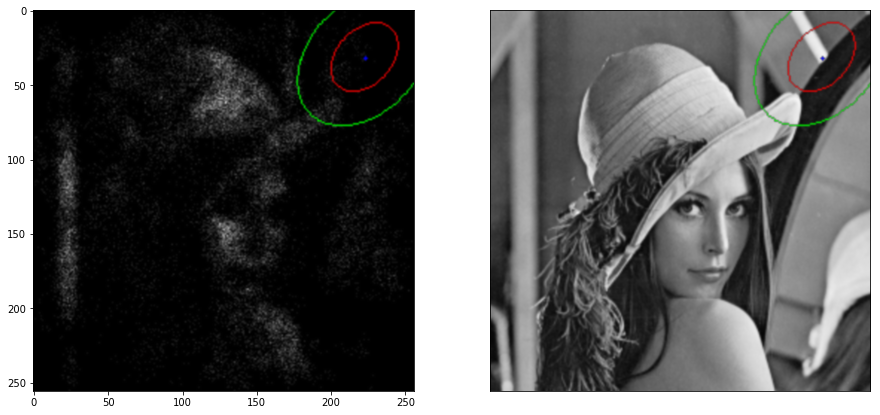

i: 30000
acceptance rate: 0.9050364987833739


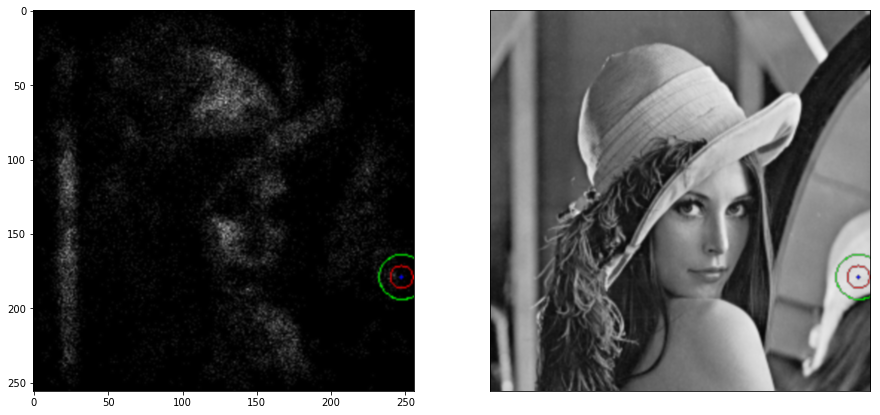

i: 31000
acceptance rate: 0.904809522273475


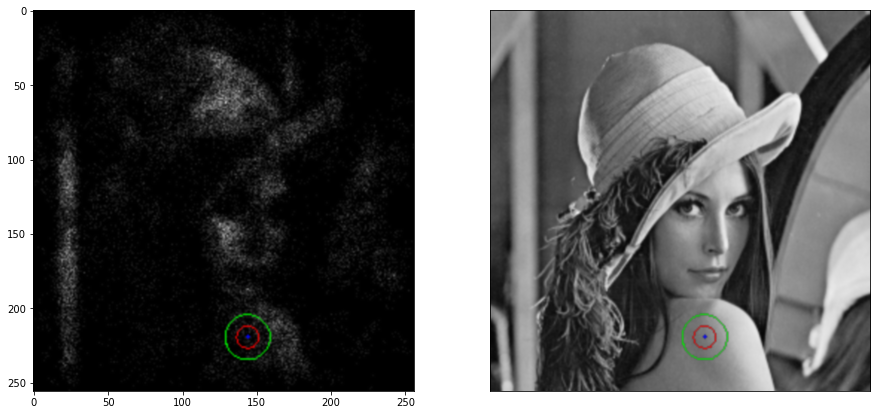

i: 32000
acceptance rate: 0.9045342333052092


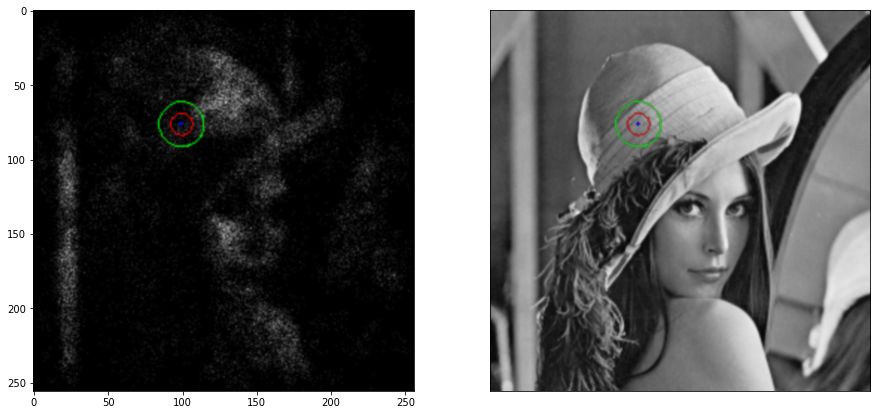

i: 33000
acceptance rate: 0.9036695857701281


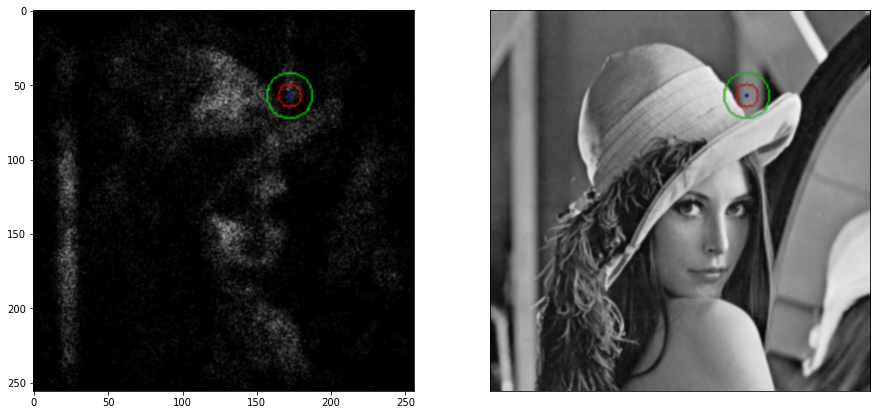

i: 34000
acceptance rate: 0.9043851651422017


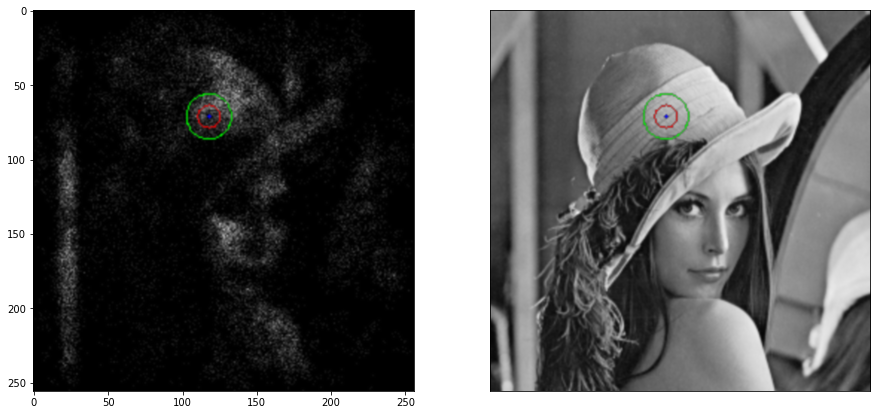

i: 35000
acceptance rate: 0.9054027027799205


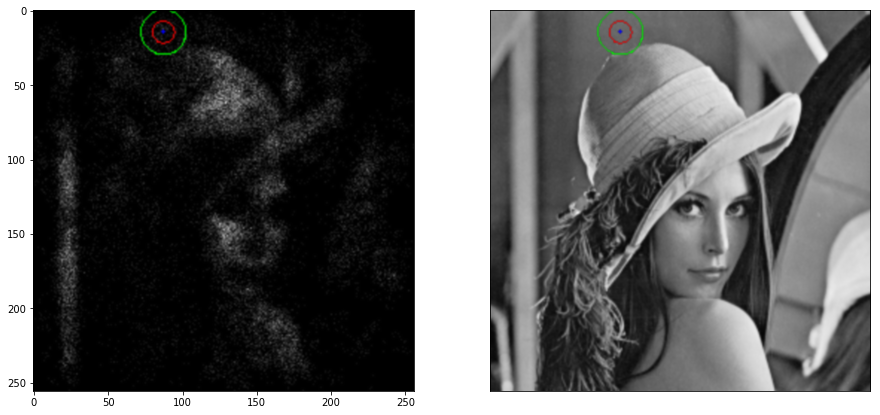

i: 36000
acceptance rate: 0.9048915307908114


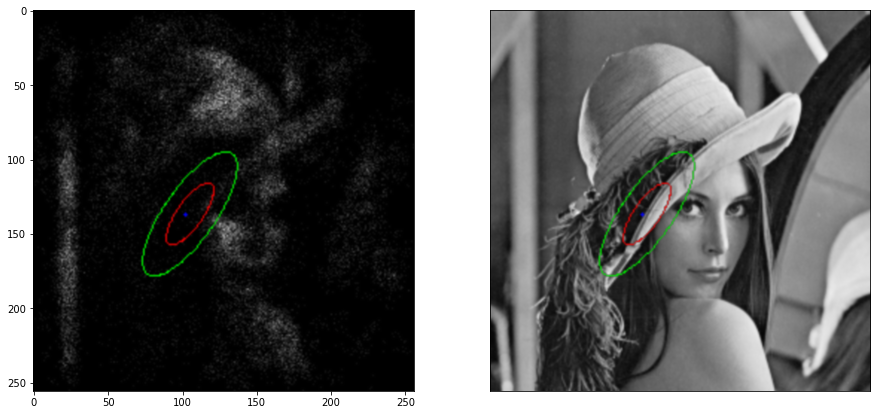

i: 37000
acceptance rate: 0.905110672684522


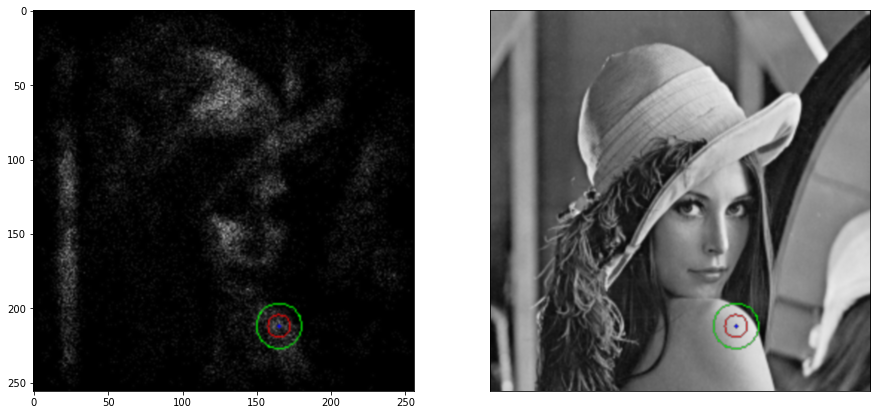

i: 38000
acceptance rate: 0.9046604036735876


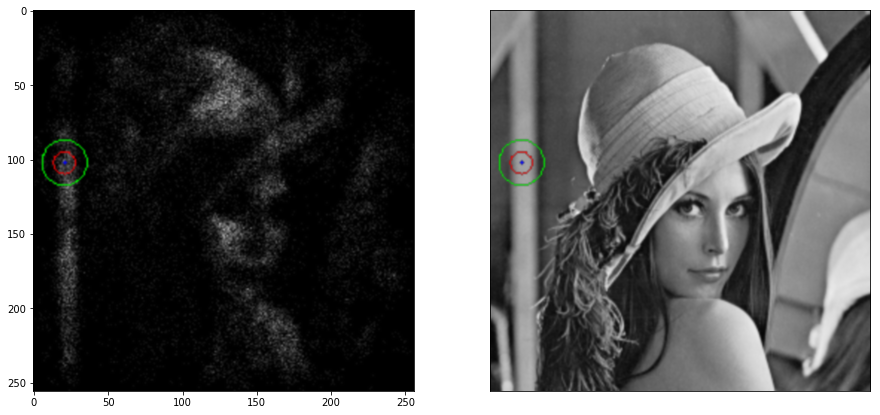

i: 39000
acceptance rate: 0.9045409092074562


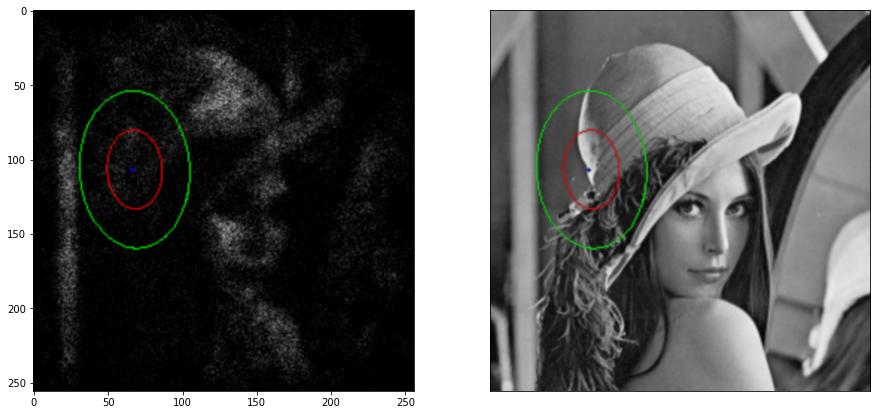

i: 40000
acceptance rate: 0.9051523711907202


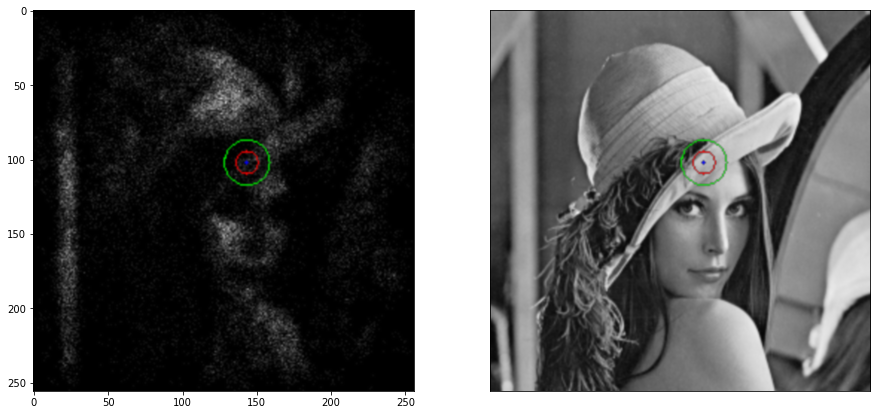

i: 41000
acceptance rate: 0.9054169410502183


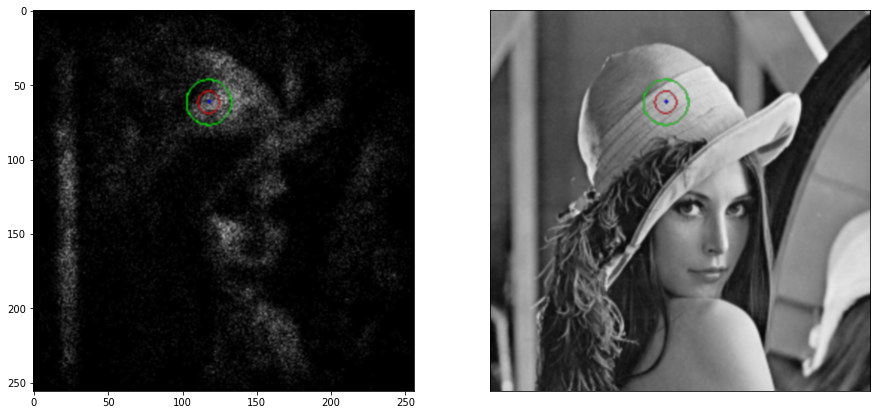

i: 42000
acceptance rate: 0.906264136568177


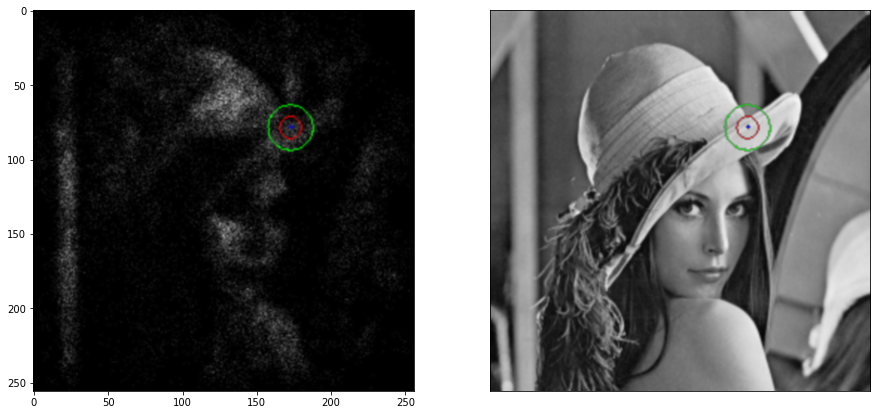

i: 43000
acceptance rate: 0.9061649729076068


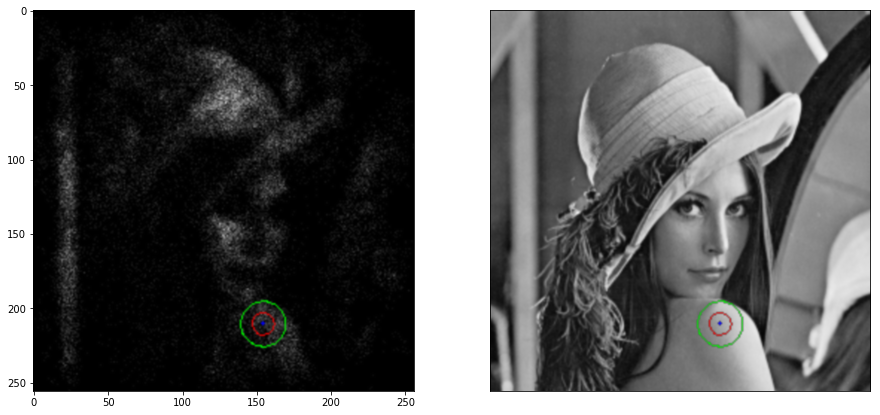

i: 44000
acceptance rate: 0.9063657644144452


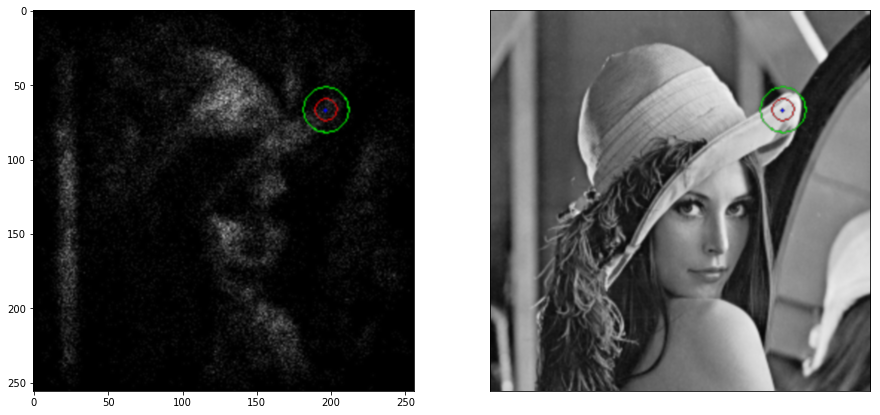

i: 45000
acceptance rate: 0.9065576320526211


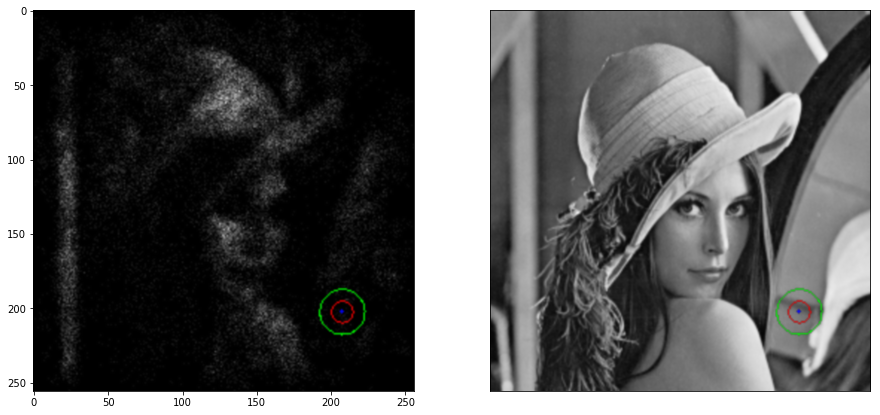

i: 46000
acceptance rate: 0.9073281015630095


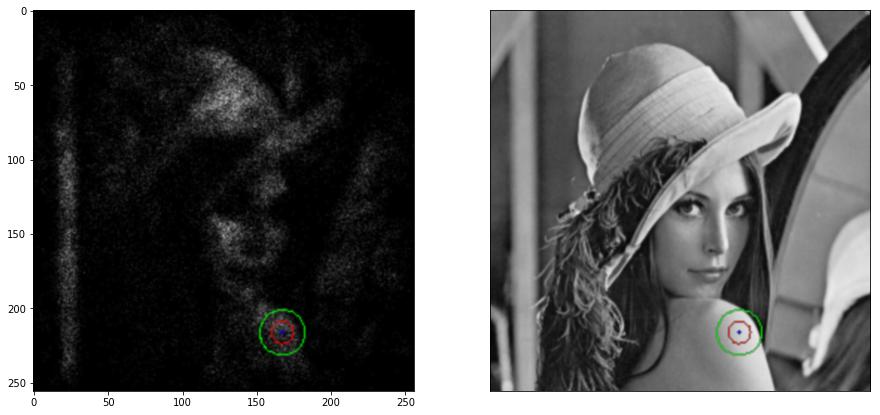

i: 47000
acceptance rate: 0.9081296142635263


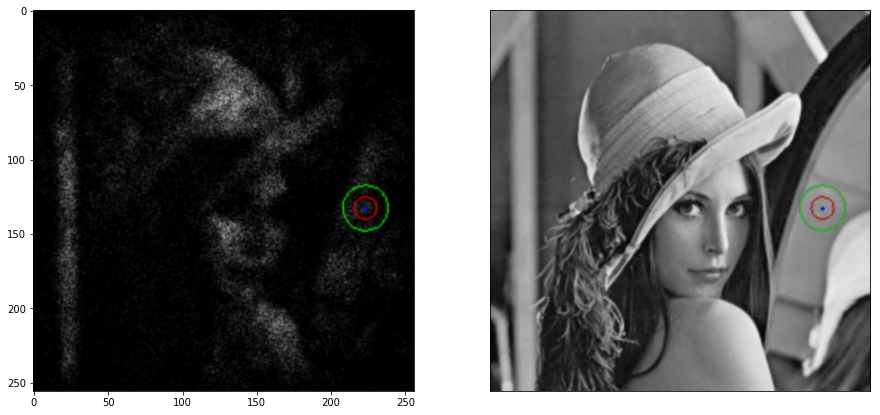

i: 48000
acceptance rate: 0.9080852482239953


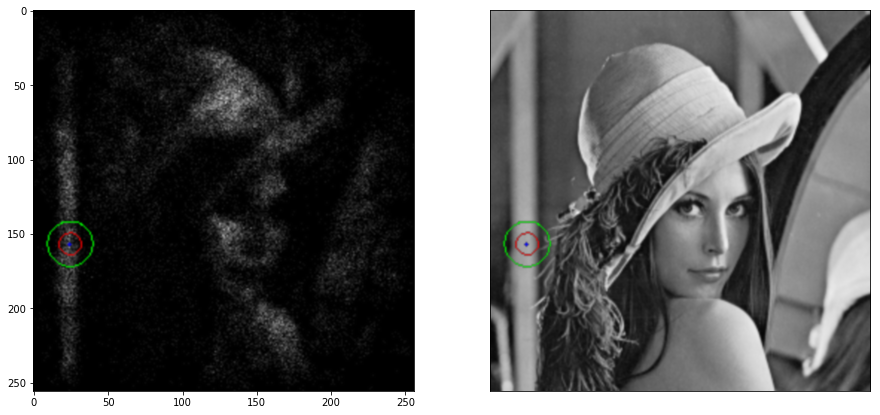

i: 49000
acceptance rate: 0.9081039162466072


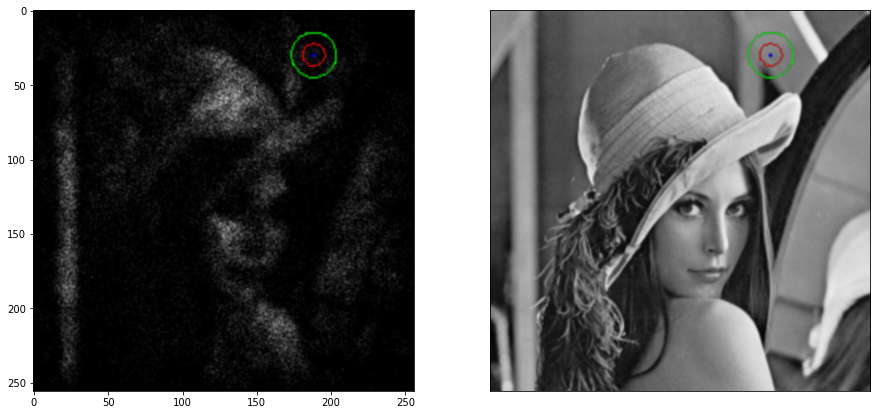

i: 50000
acceptance rate: 0.9084018319633608


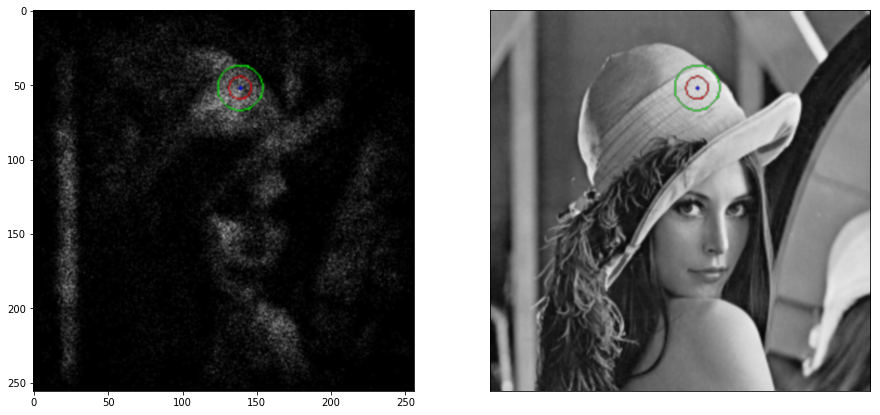

i: 51000
acceptance rate: 0.9090017842787397


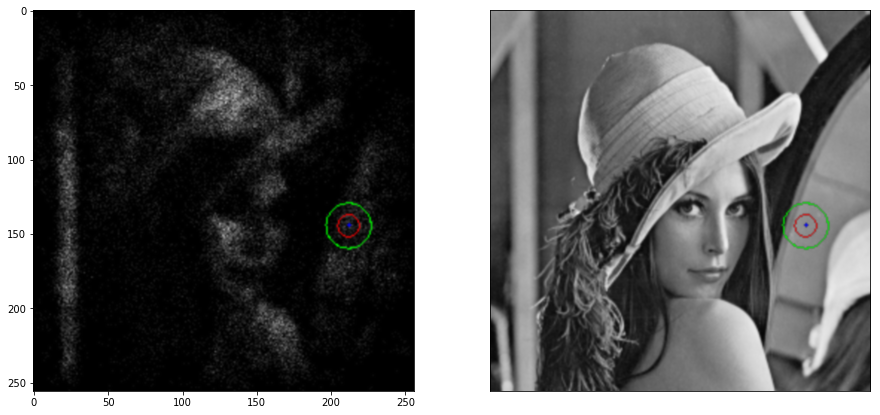

i: 52000
acceptance rate: 0.9090209803657622


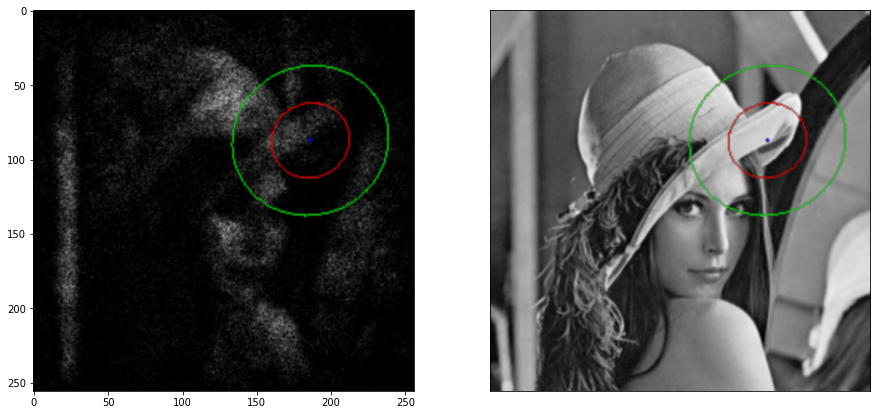

i: 53000
acceptance rate: 0.9088507764004453


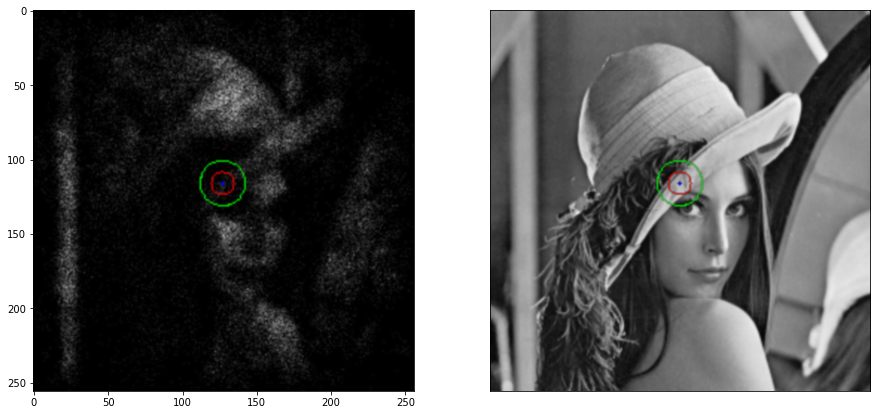

i: 54000
acceptance rate: 0.9088535397492639


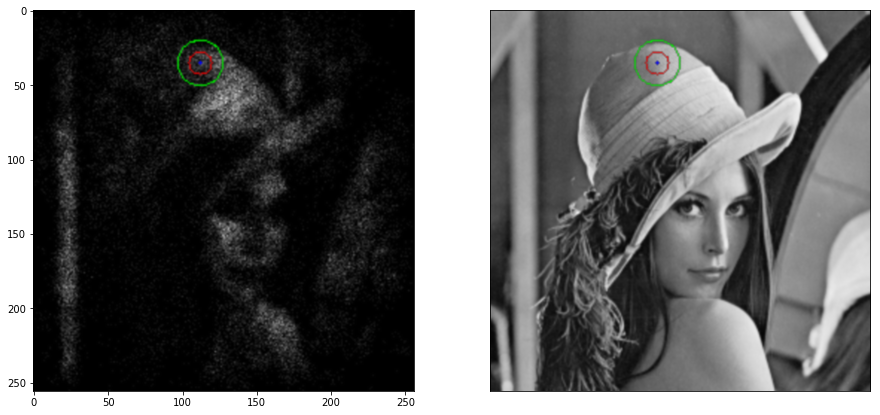

i: 55000
acceptance rate: 0.9089289285649352


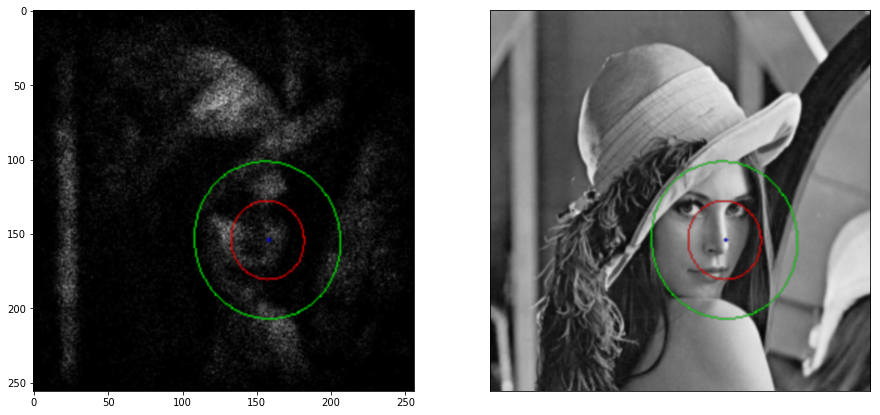

i: 56000
acceptance rate: 0.9089659113230121


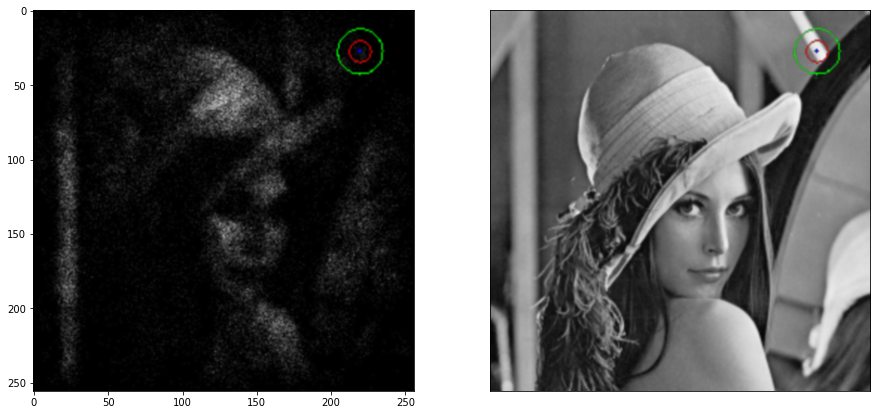

i: 57000
acceptance rate: 0.9085454641146646


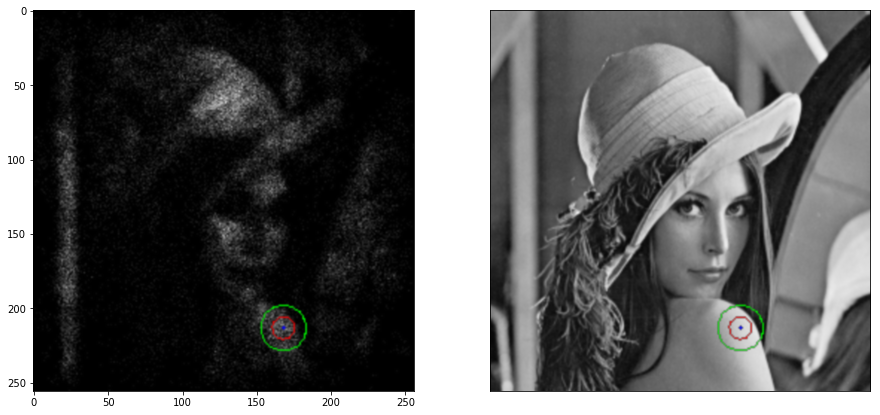

i: 58000
acceptance rate: 0.9087084705436114


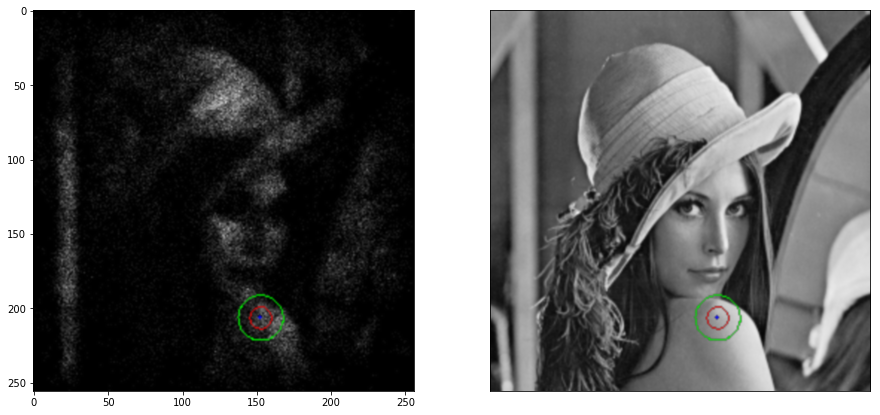

i: 59000
acceptance rate: 0.9084761275232623


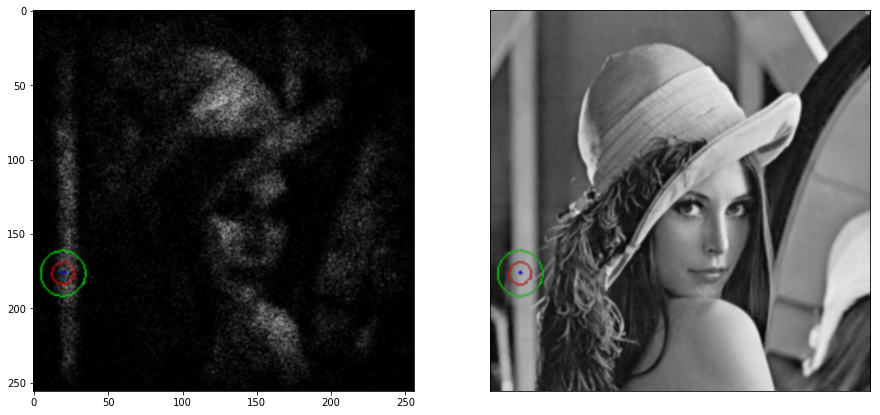

i: 60000
acceptance rate: 0.9077348710854819


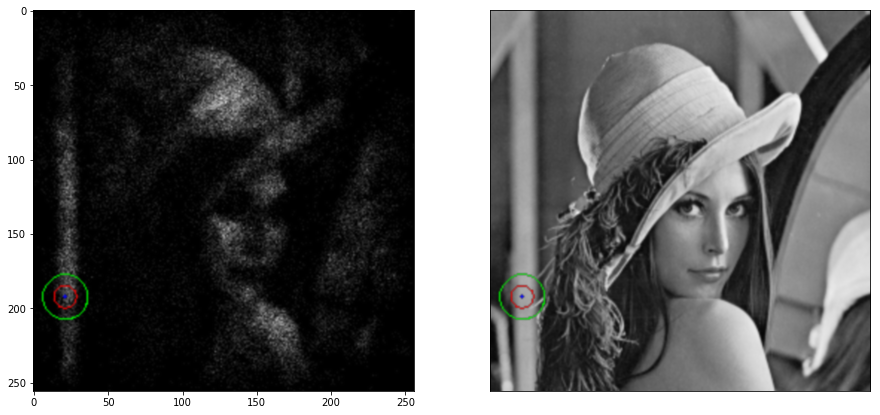

i: 61000
acceptance rate: 0.9076408583465845


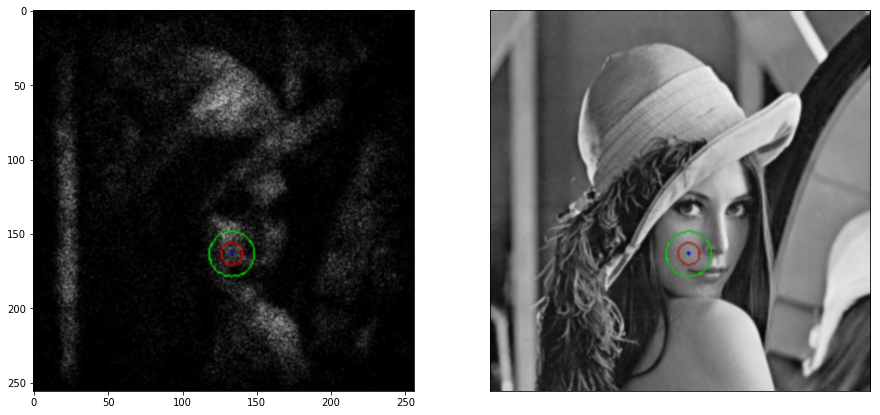

i: 62000
acceptance rate: 0.9077756810374026


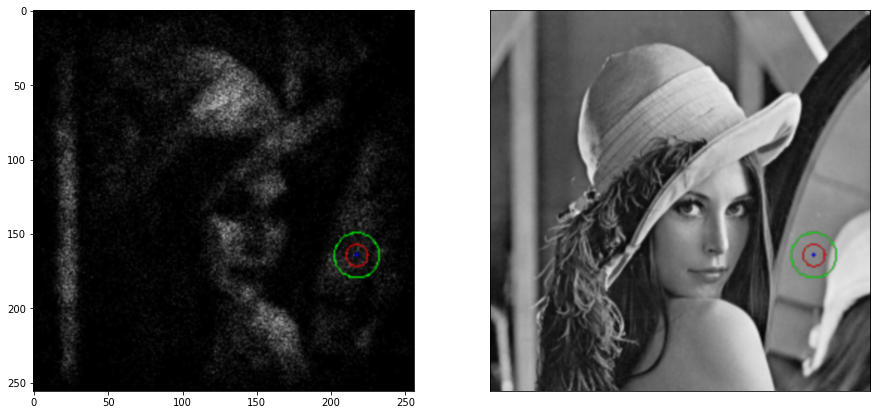

i: 63000
acceptance rate: 0.9081284424056761


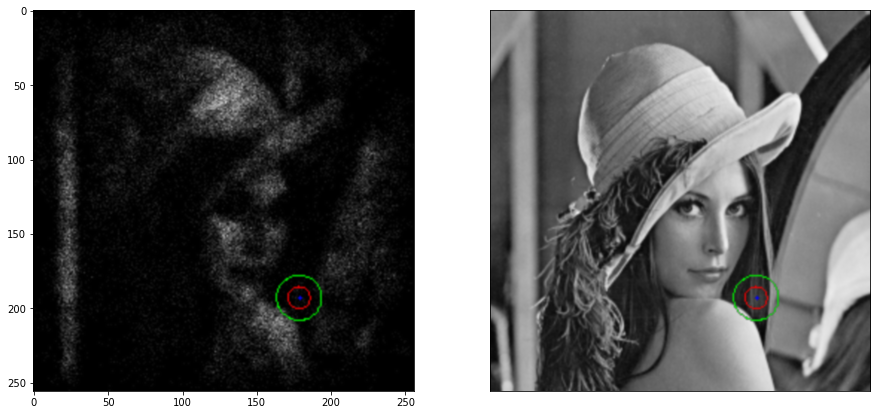

i: 64000
acceptance rate: 0.9082514335713504


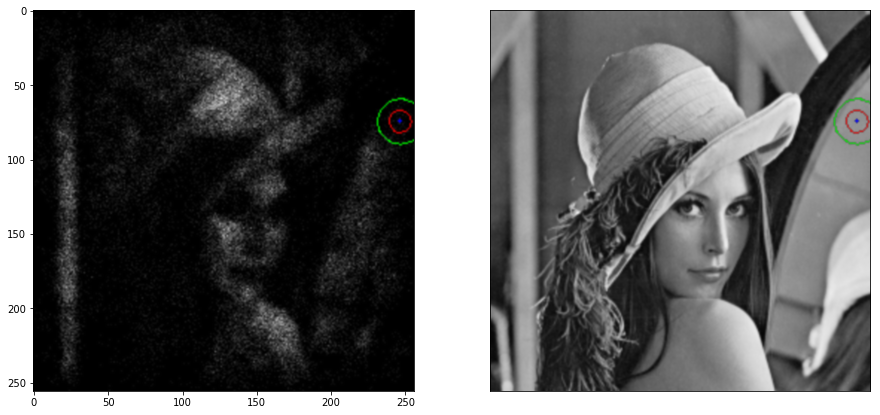

i: 65000
acceptance rate: 0.9078783403332257


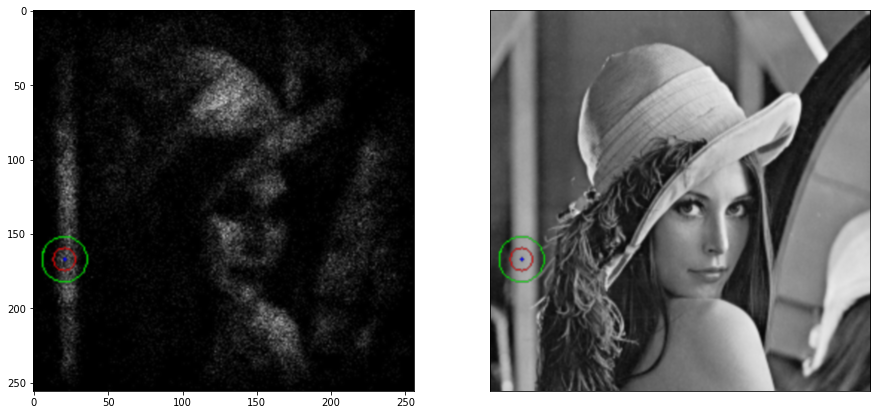

i: 66000
acceptance rate: 0.9076529143497826


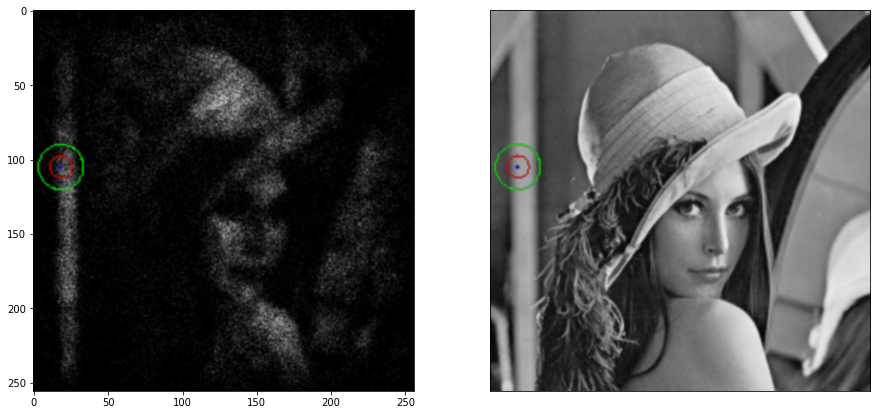

i: 67000
acceptance rate: 0.9075536186027074


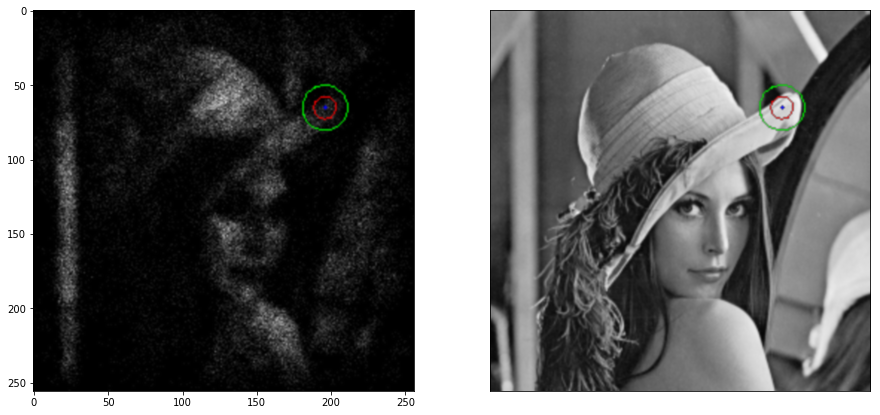

i: 68000
acceptance rate: 0.907030778959133


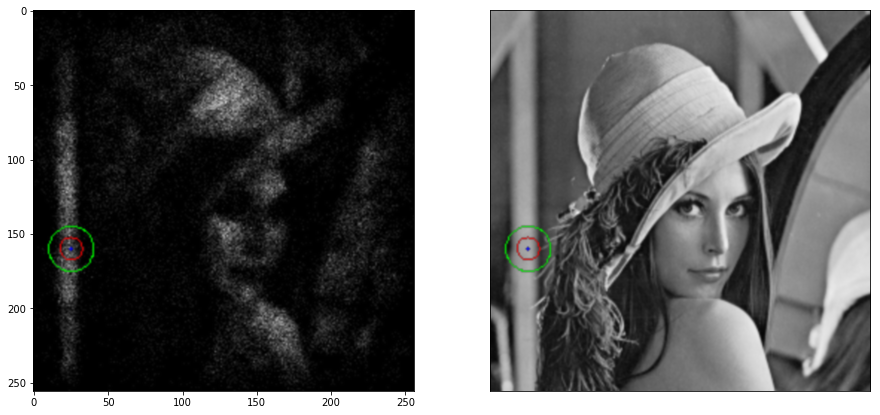

i: 69000
acceptance rate: 0.9065665714989638


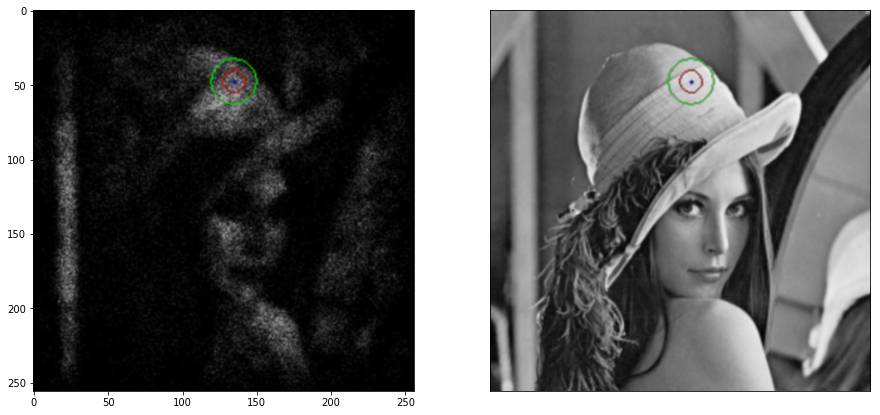

i: 70000
acceptance rate: 0.9053727803888516


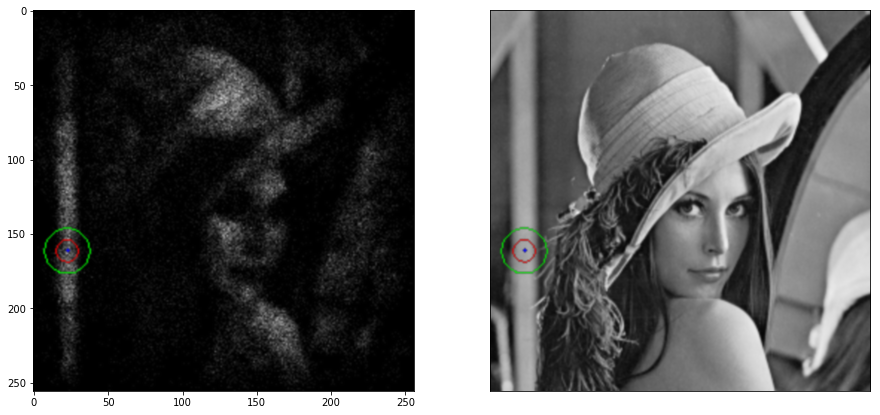

i: 71000
acceptance rate: 0.9047619047619048


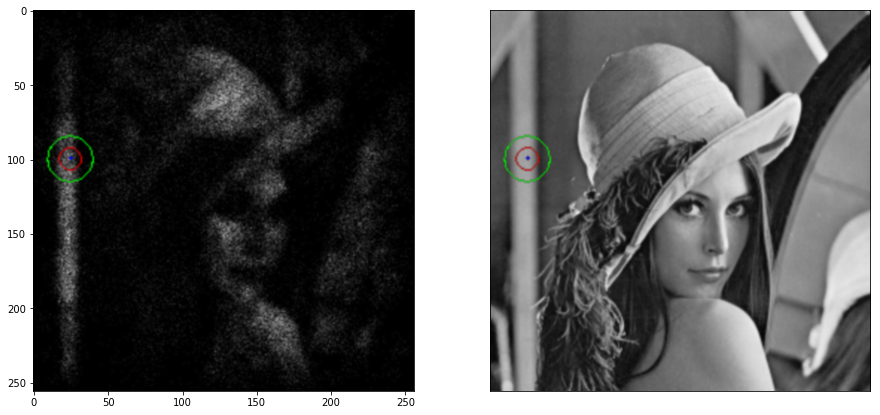

i: 72000
acceptance rate: 0.904542992458438


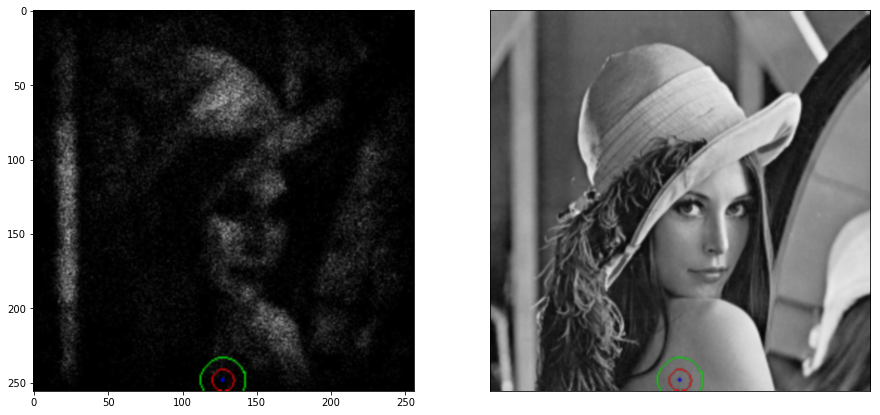

i: 73000
acceptance rate: 0.904179394802811


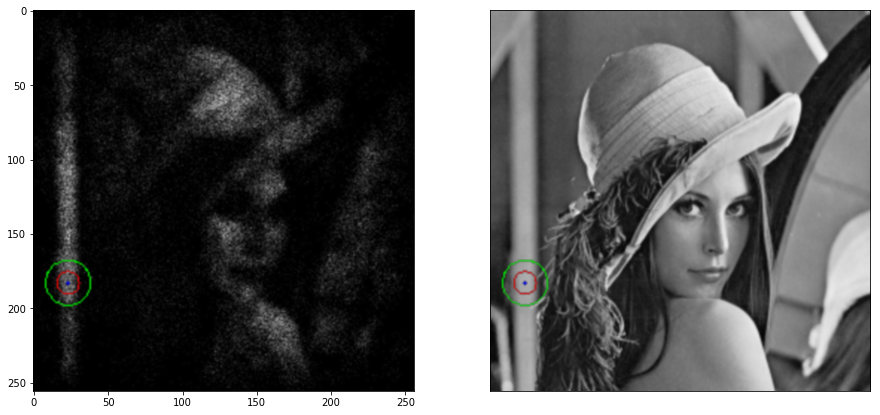

i: 74000
acceptance rate: 0.9036634640072432


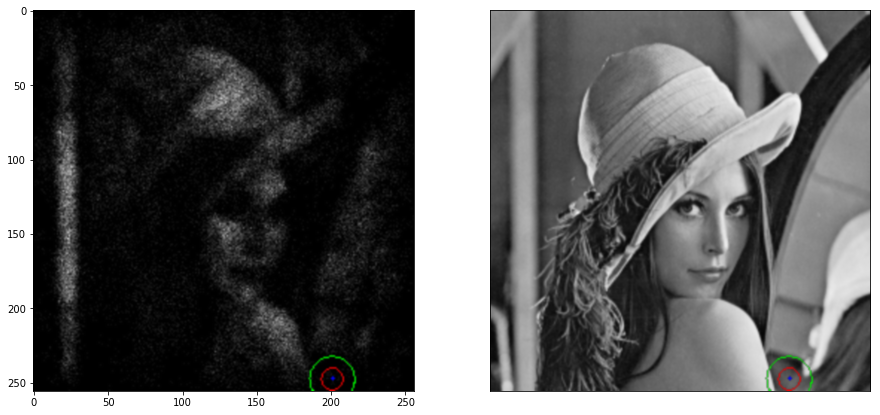

i: 75000
acceptance rate: 0.9039479473607018


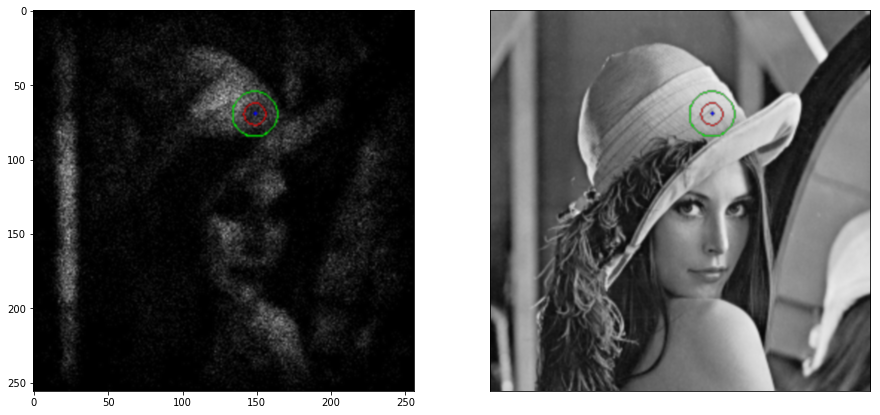

i: 76000
acceptance rate: 0.9040275785844923


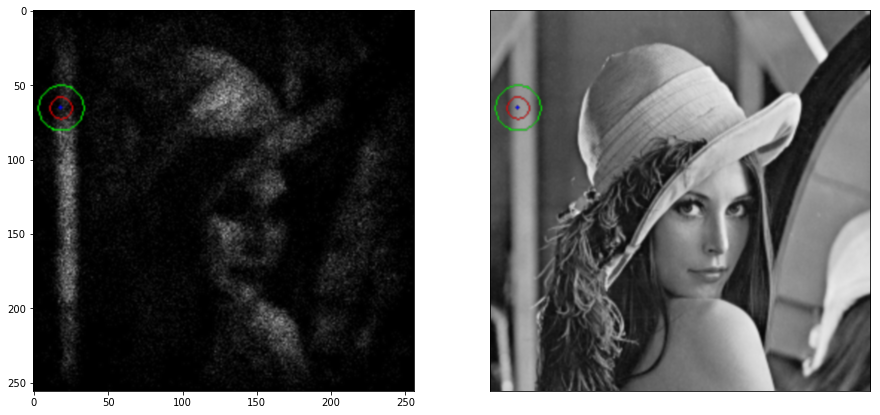

i: 77000
acceptance rate: 0.9040921546473423


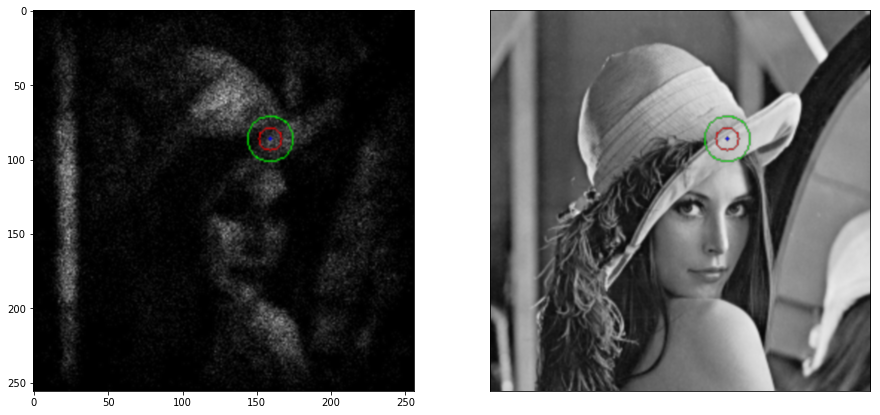

i: 78000
acceptance rate: 0.9040653324957373


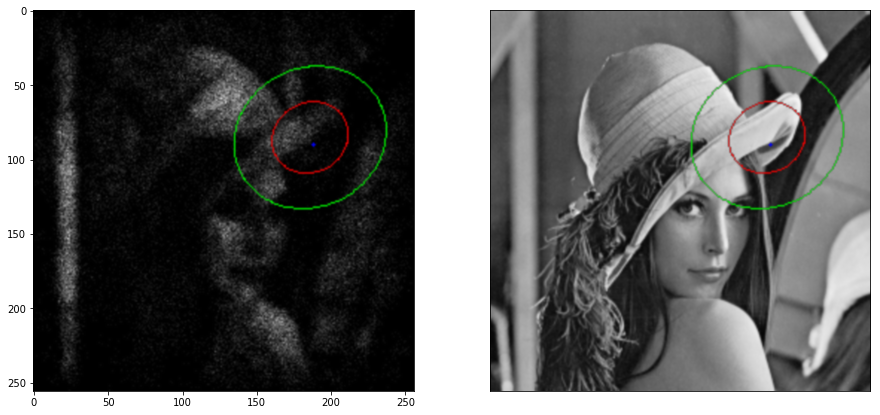

i: 79000
acceptance rate: 0.903634131213529


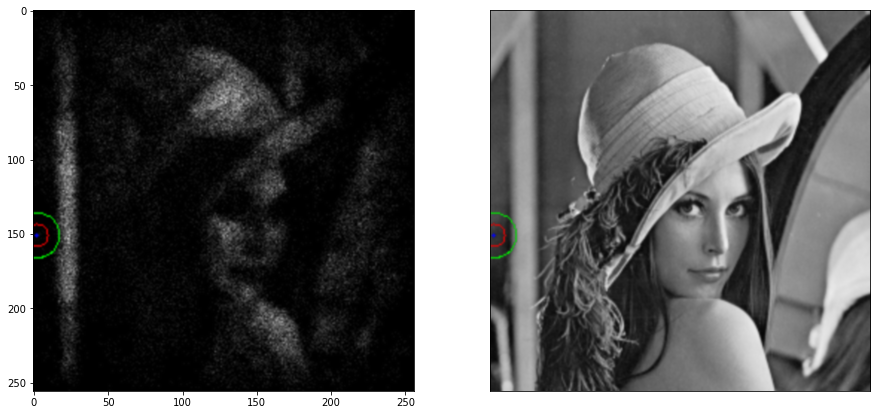

i: 80000
acceptance rate: 0.9039262009224884


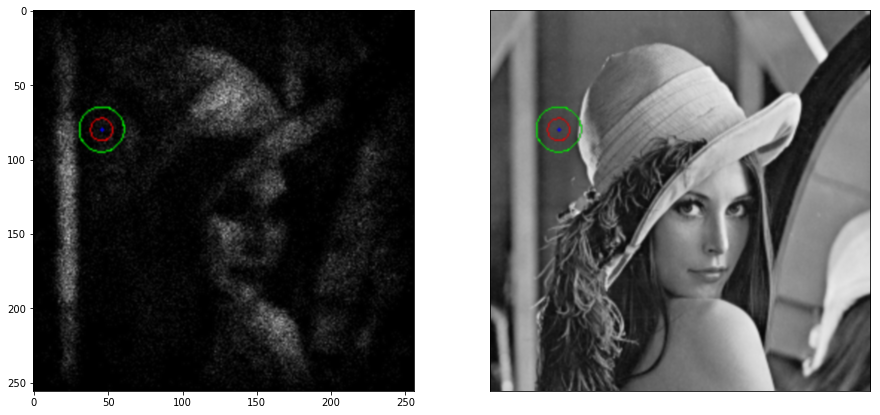

i: 81000
acceptance rate: 0.9039641485907581


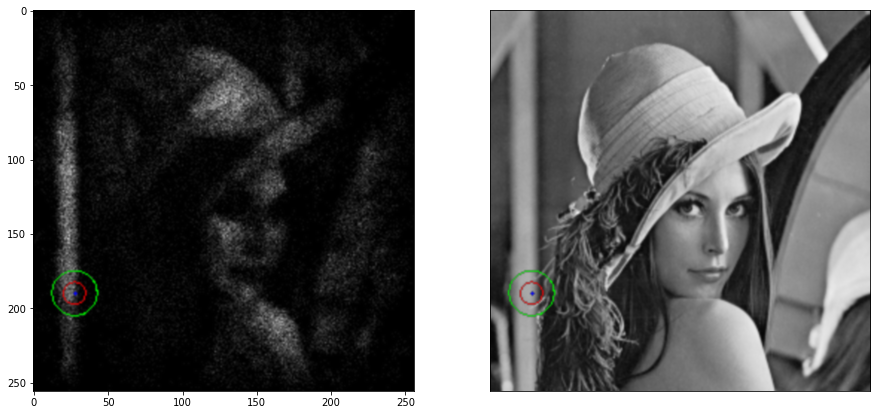

i: 82000
acceptance rate: 0.9036719064401654


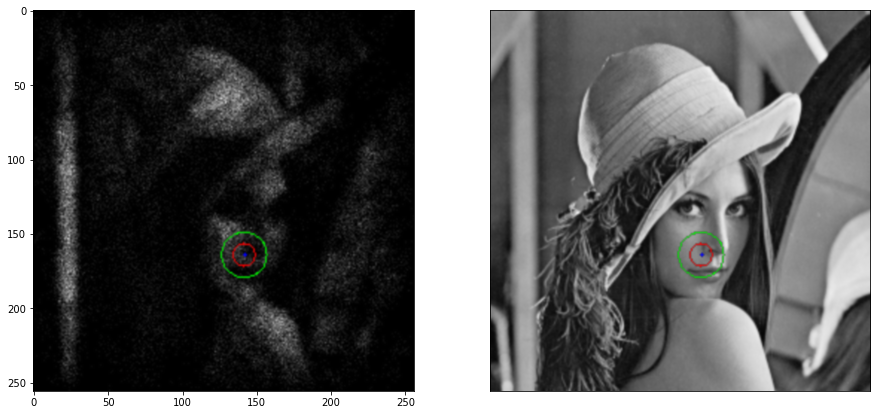

i: 83000
acceptance rate: 0.903892724184046


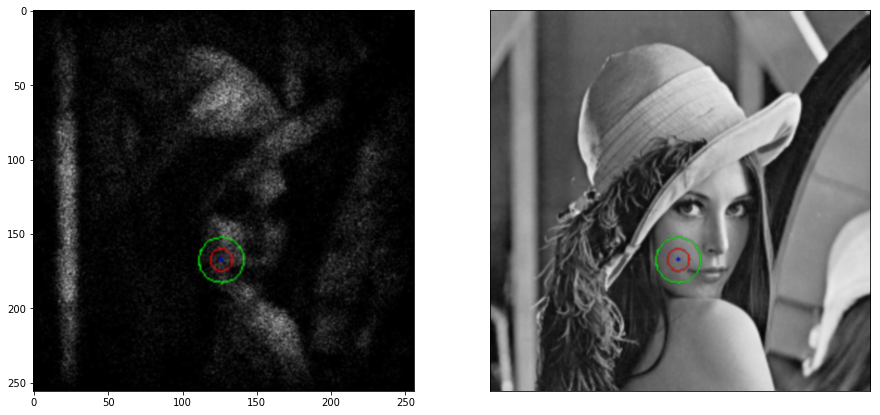

i: 84000
acceptance rate: 0.9035844811371293


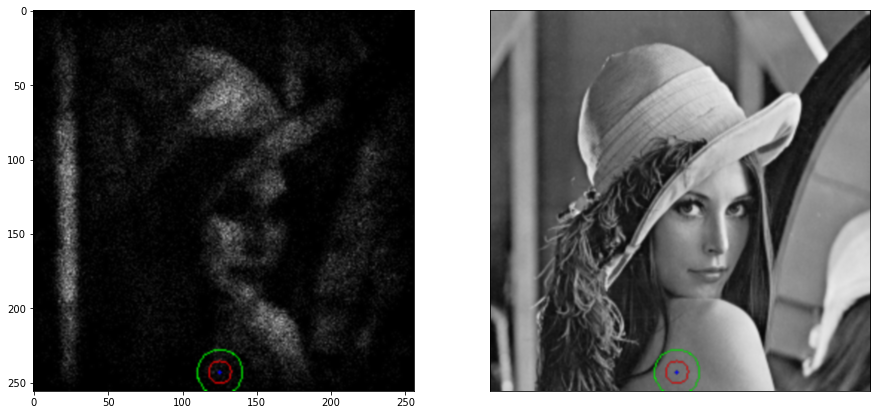

i: 85000
acceptance rate: 0.9039187774261479


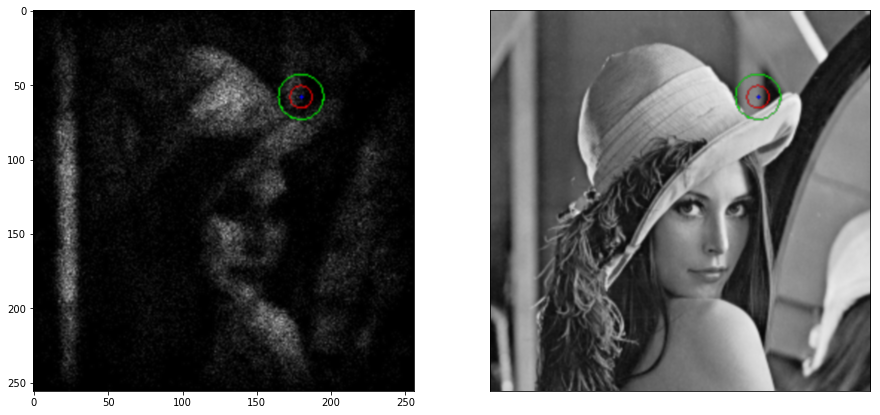

i: 86000
acceptance rate: 0.904256927245032


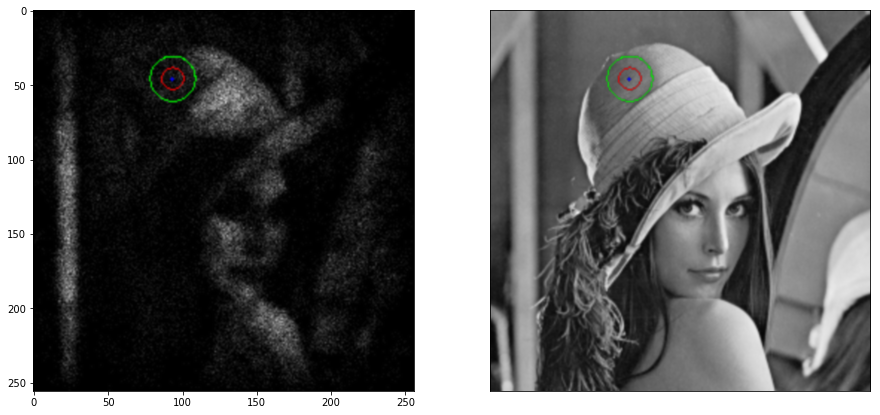

i: 87000
acceptance rate: 0.9044838565073965


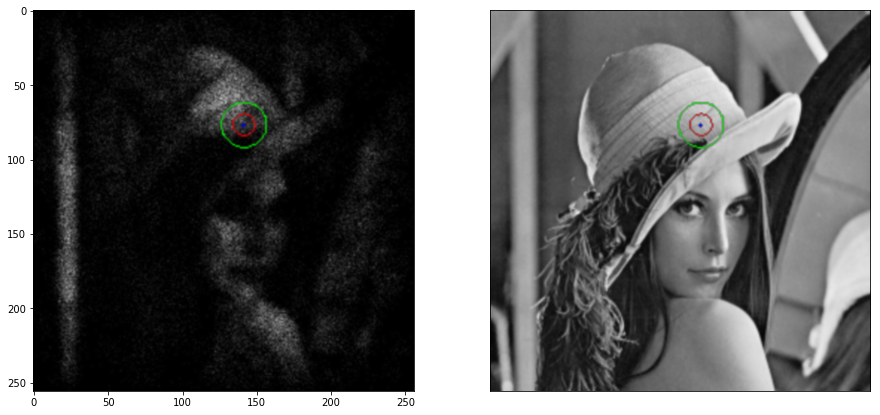

i: 88000
acceptance rate: 0.9041374529834888


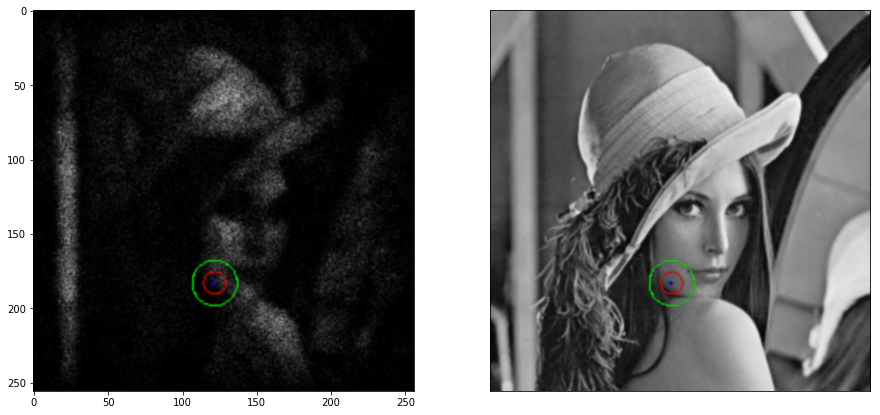

i: 89000
acceptance rate: 0.9041920877293513


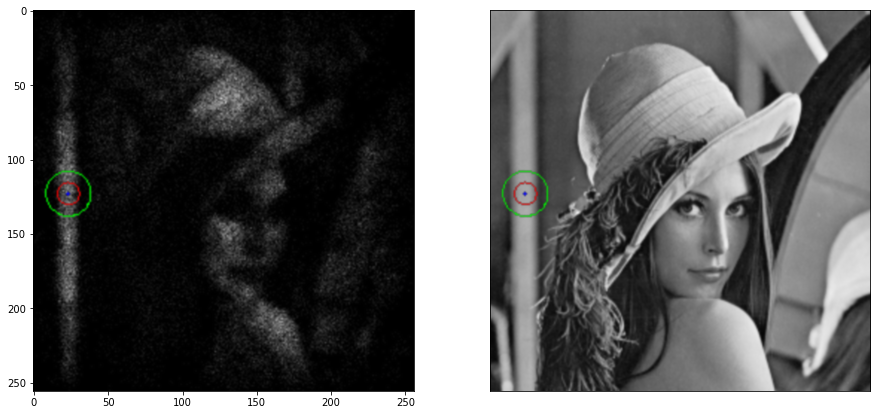

i: 90000
acceptance rate: 0.9040566215930934


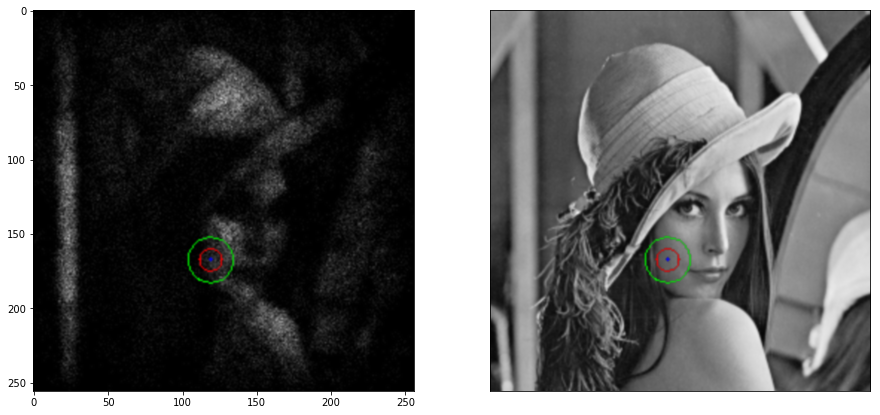

i: 91000
acceptance rate: 0.9041548993967099


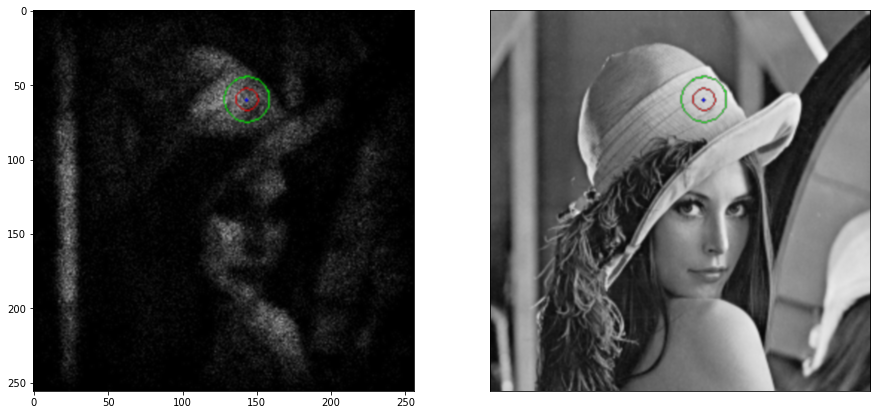

i: 92000
acceptance rate: 0.9043706046673405


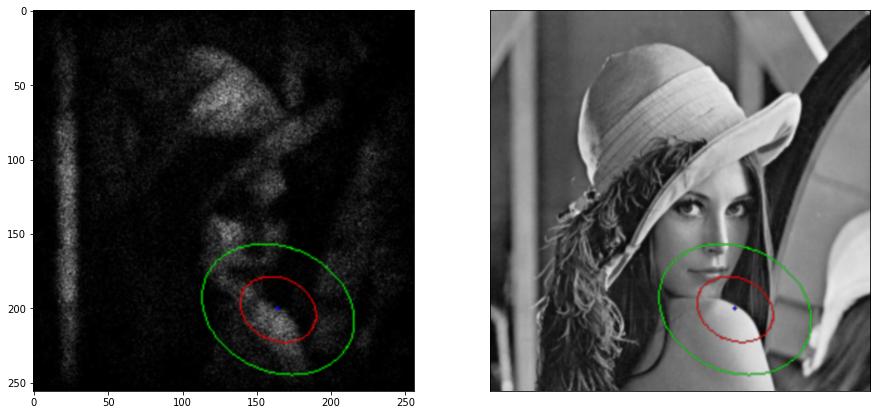

i: 93000
acceptance rate: 0.9046031763099321


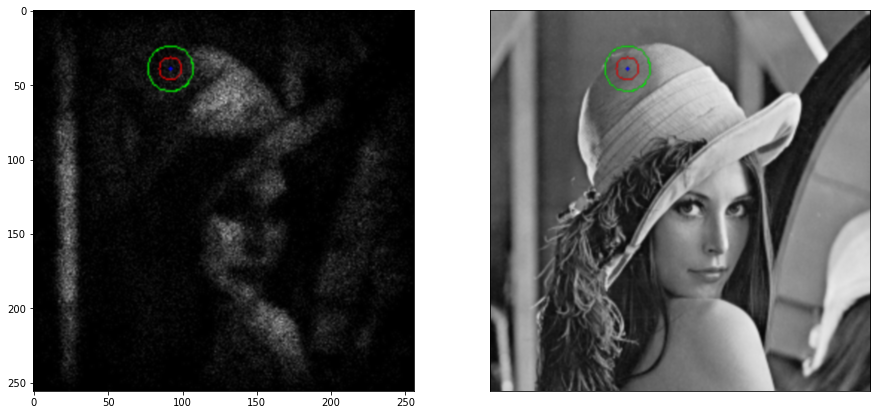

i: 94000
acceptance rate: 0.9049052669652451


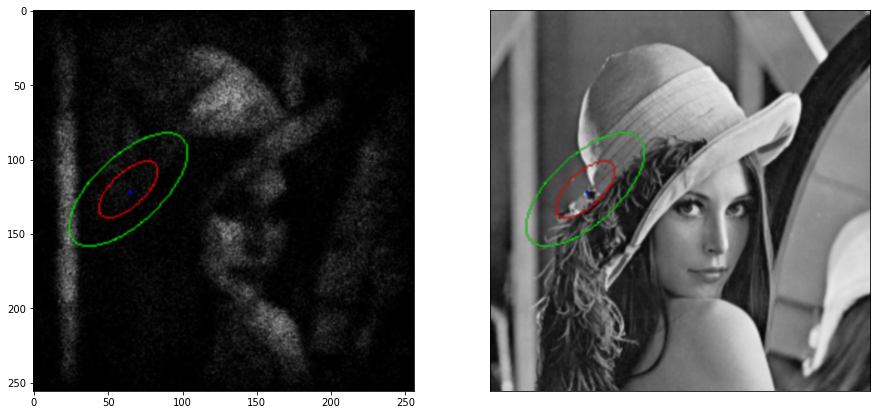

i: 95000
acceptance rate: 0.904674687634867


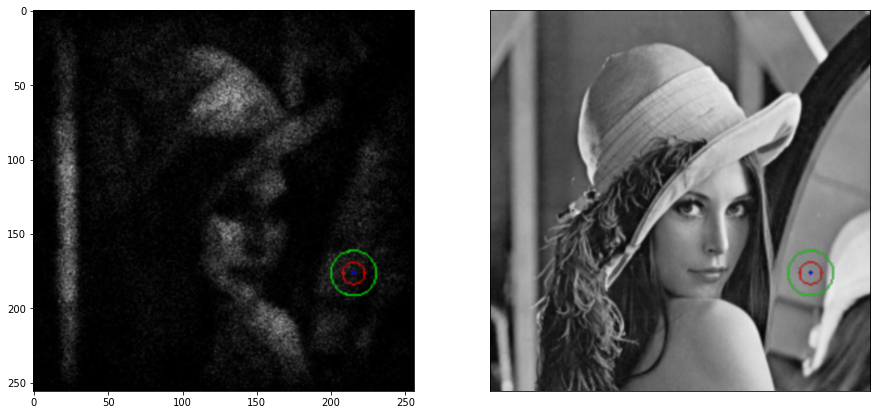

i: 96000
acceptance rate: 0.9041989145946396


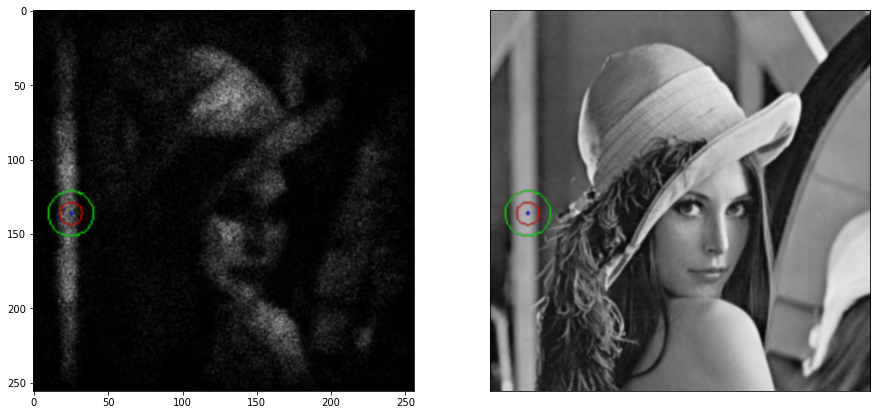

i: 97000
acceptance rate: 0.9040937722291523


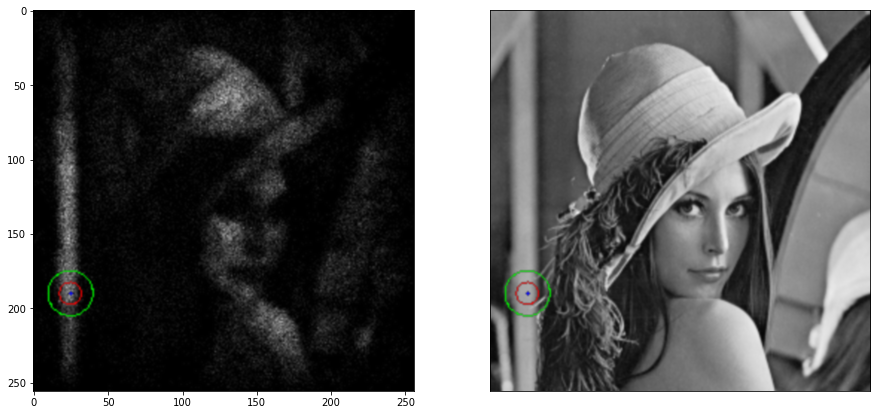

i: 98000
acceptance rate: 0.9040622034469036


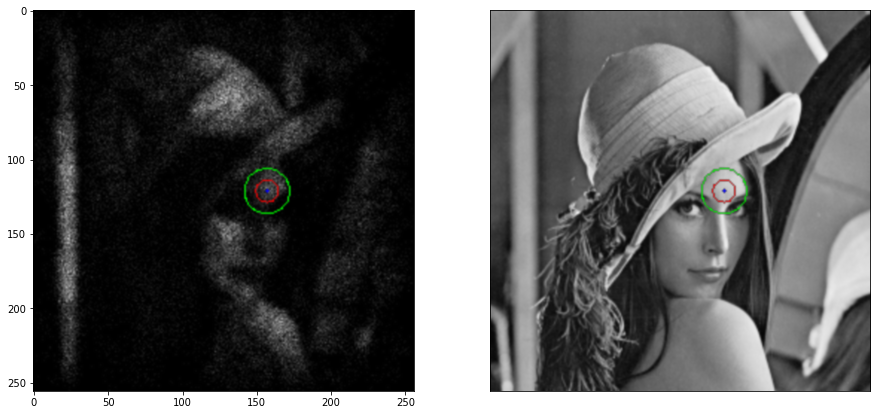

i: 99000
acceptance rate: 0.9042029878486076


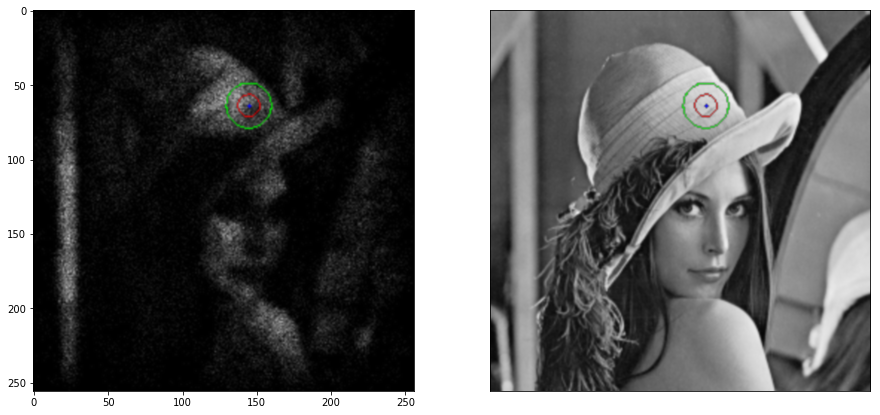

i: 100000
acceptance rate: 0.9044009559904401


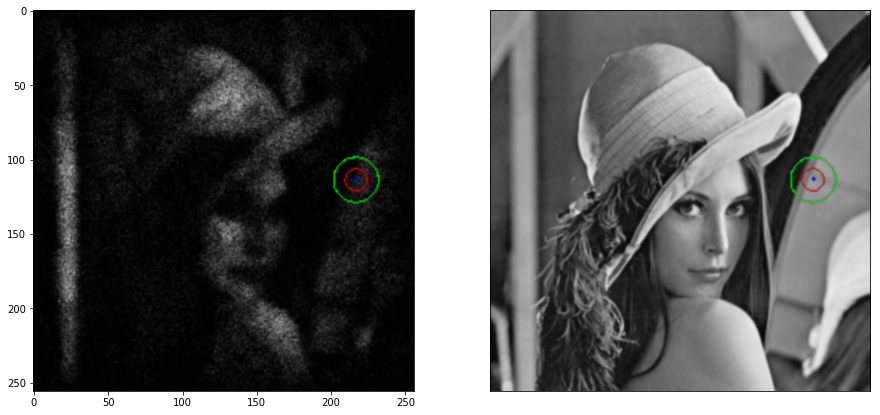

i: 101000
acceptance rate: 0.9045256977653686


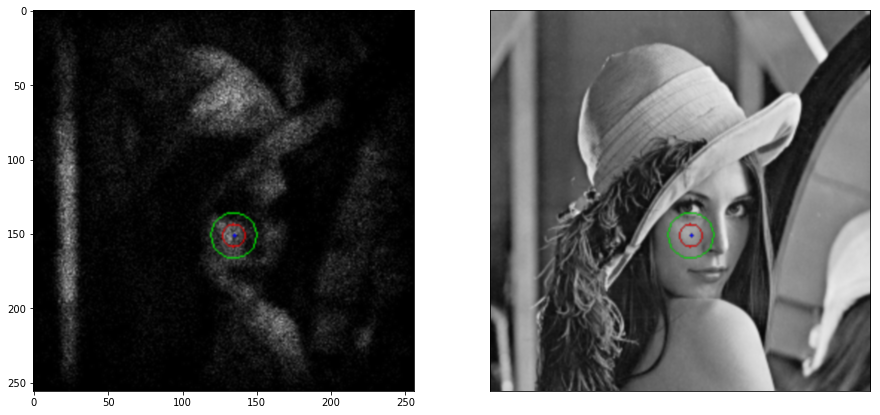

i: 102000
acceptance rate: 0.9040205488181489


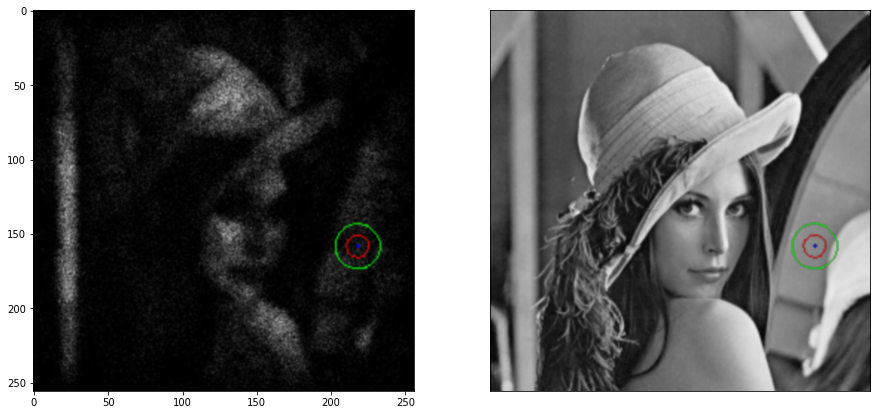

i: 103000
acceptance rate: 0.9041465616838672


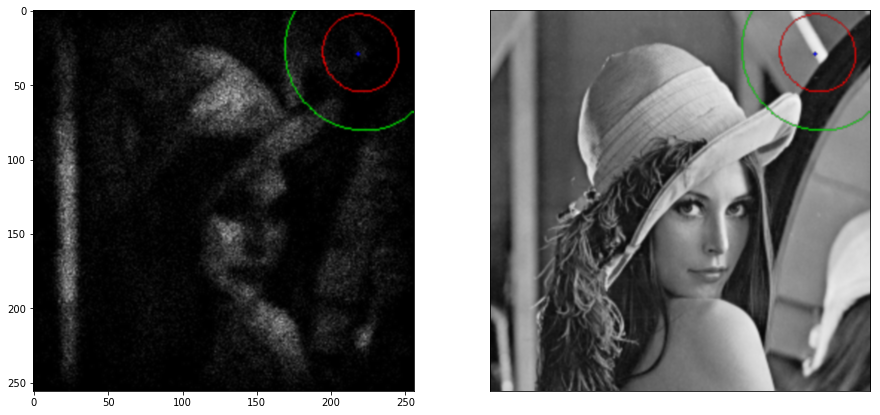

i: 104000
acceptance rate: 0.9041355371582965


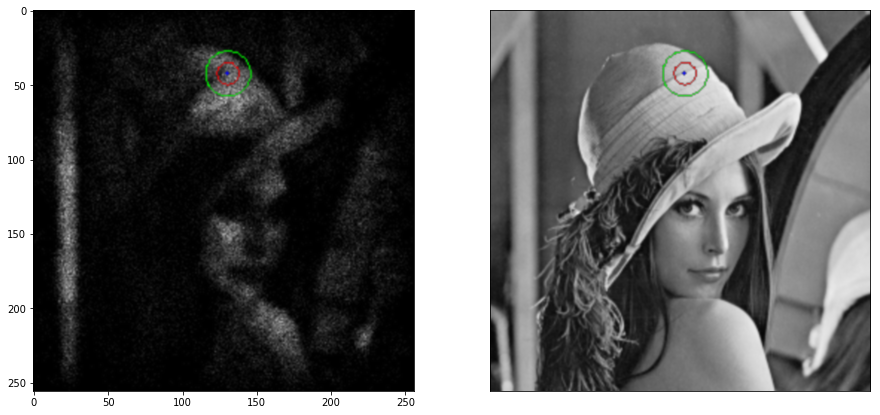

i: 105000
acceptance rate: 0.9043151969981238


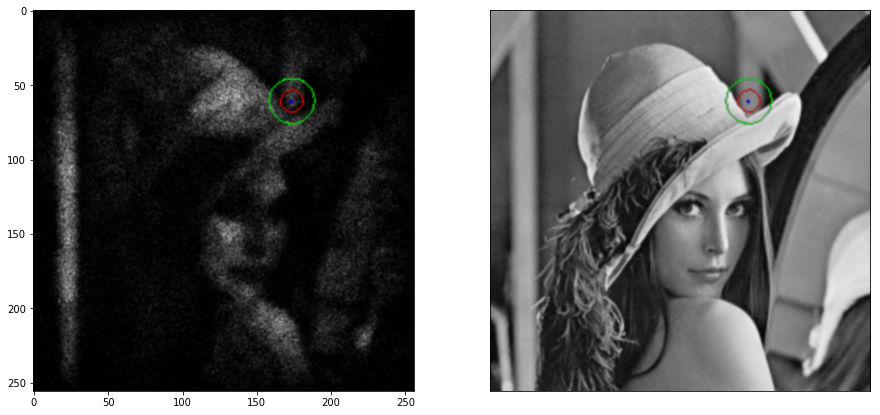

i: 106000
acceptance rate: 0.9044725993151008


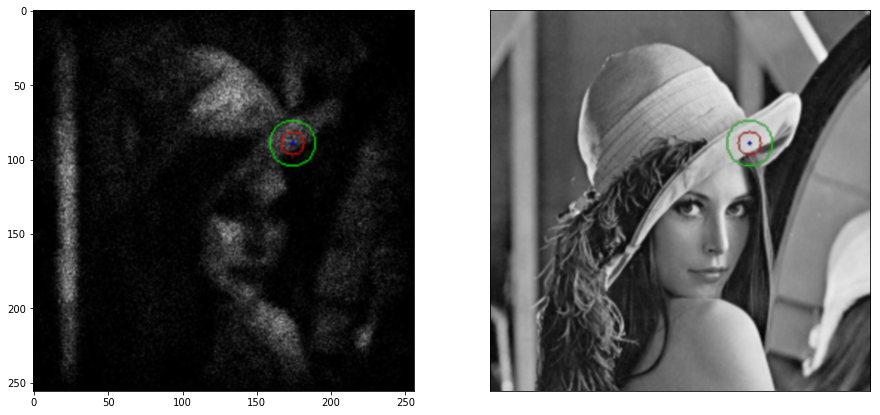

i: 107000
acceptance rate: 0.9044962196614985


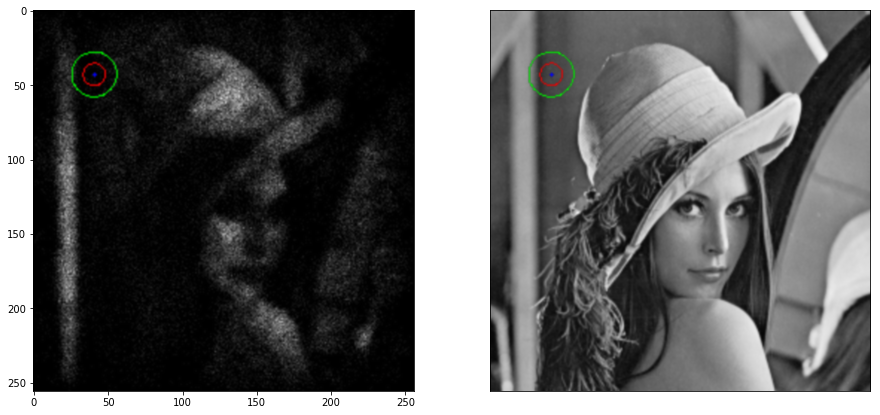

i: 108000
acceptance rate: 0.9046397718539643


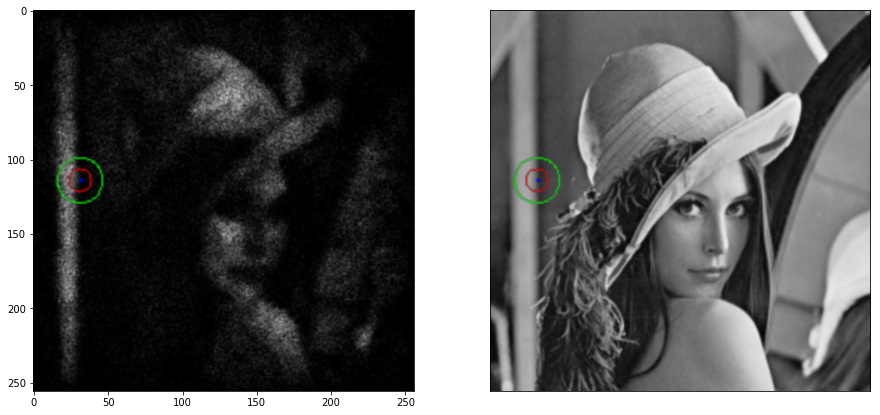

i: 109000
acceptance rate: 0.9044687663415932


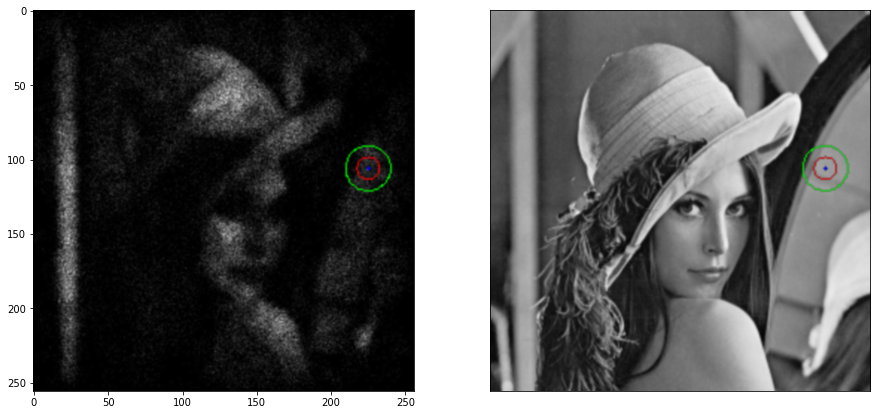

i: 110000
acceptance rate: 0.904891773711148


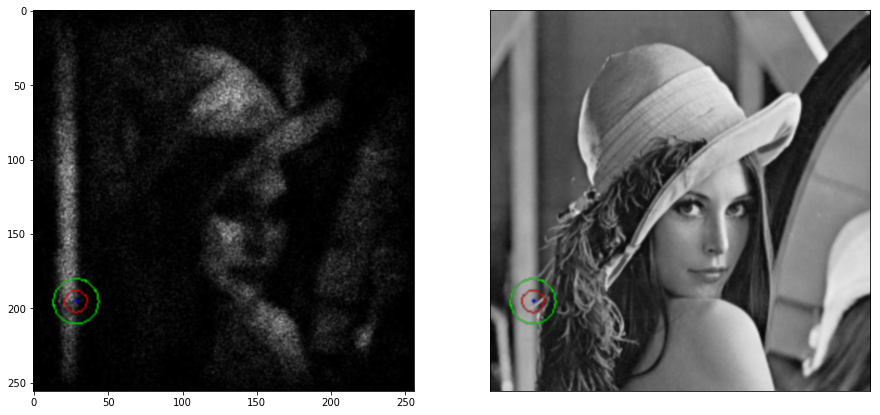

i: 111000
acceptance rate: 0.9049107665696705


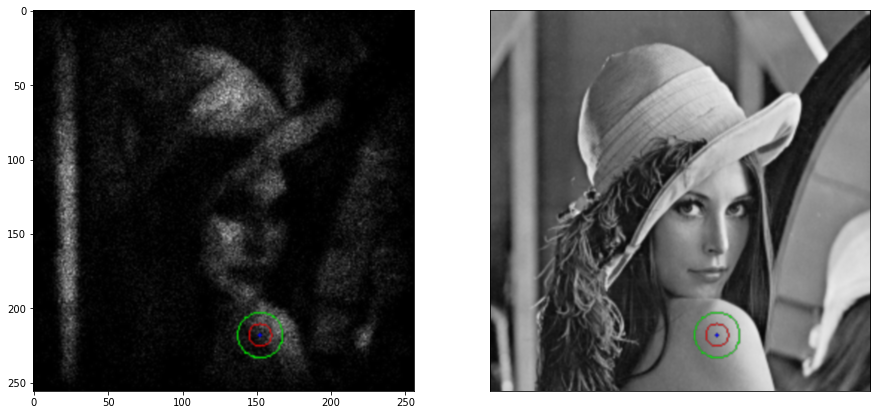

i: 112000
acceptance rate: 0.904697279488576


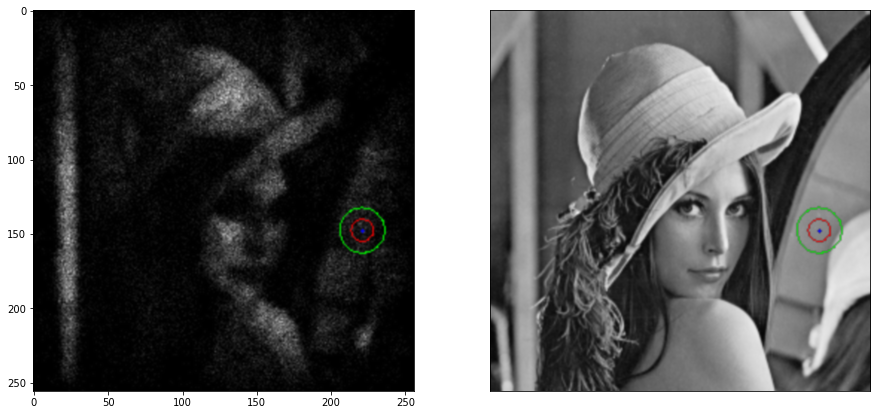

i: 113000
acceptance rate: 0.9046822594490315


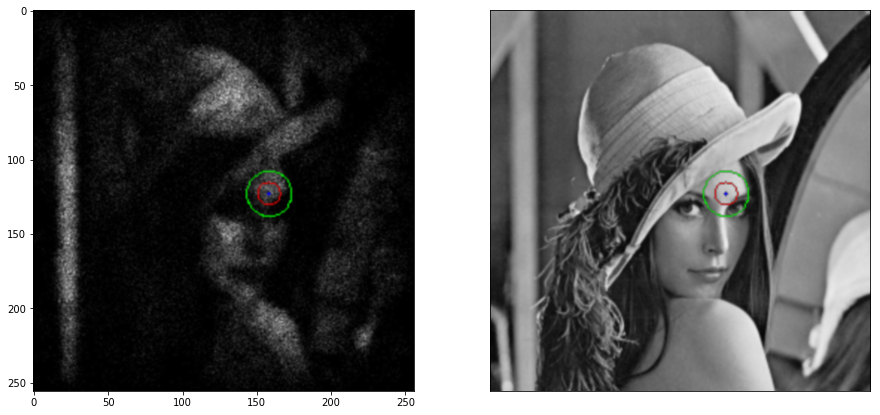

i: 114000
acceptance rate: 0.9047990807098183


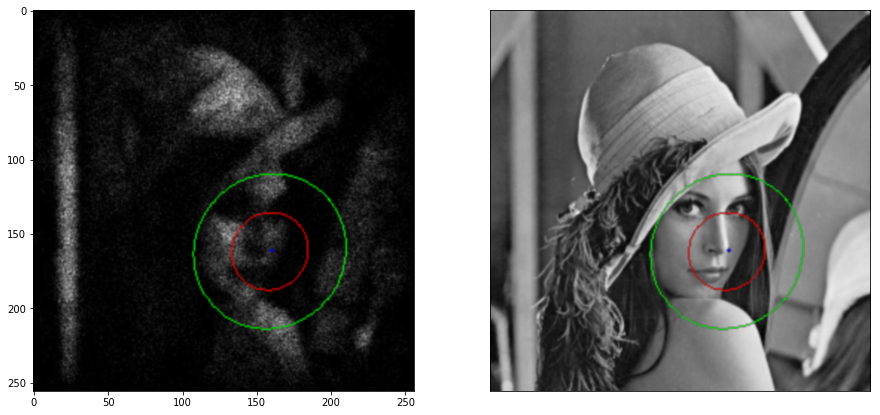

i: 115000
acceptance rate: 0.9044964826392814


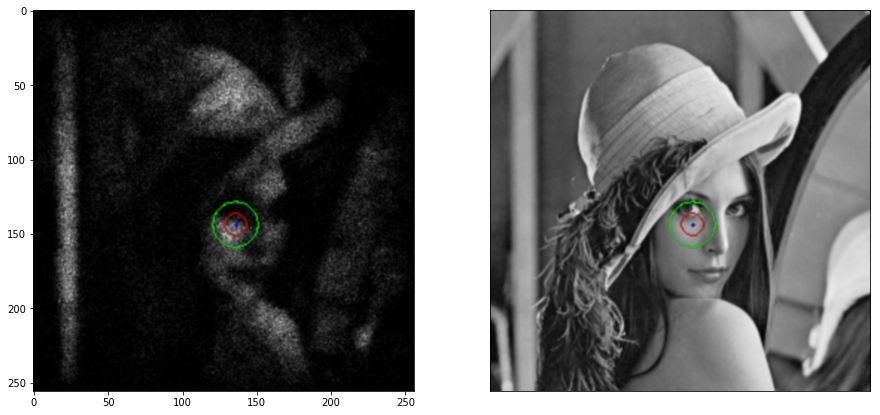

i: 116000
acceptance rate: 0.9044577201920673


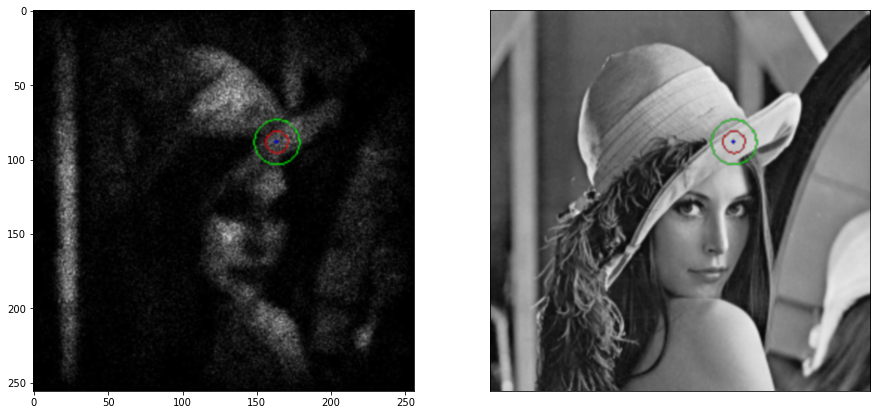

i: 117000
acceptance rate: 0.904658934539021


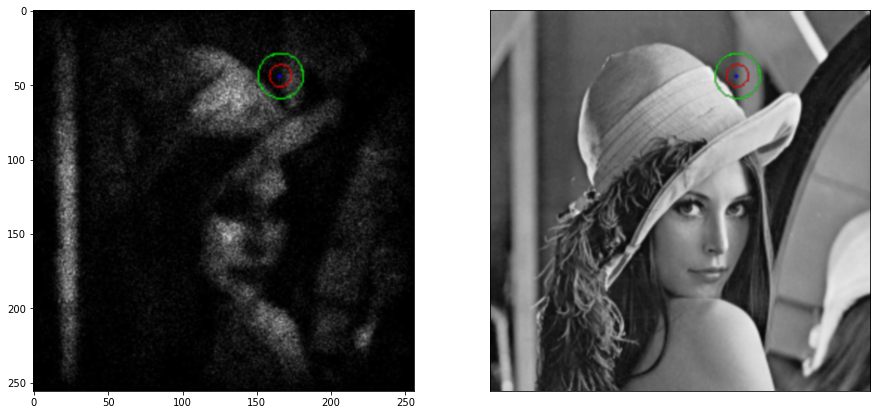

i: 118000
acceptance rate: 0.9048906365200295


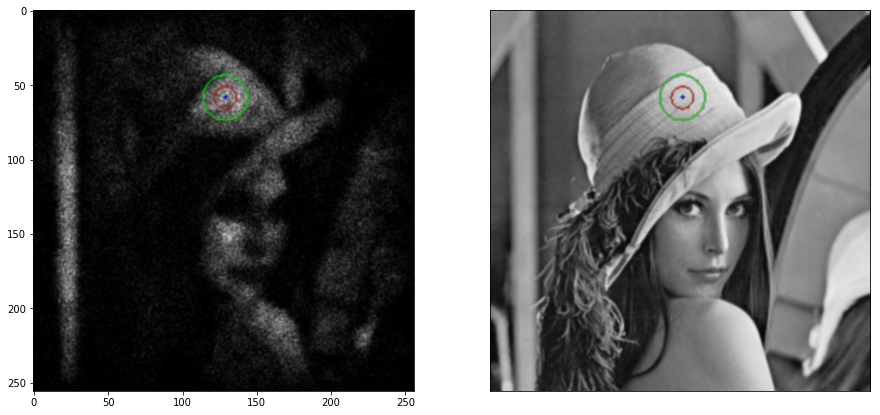

i: 119000
acceptance rate: 0.9048495390795035


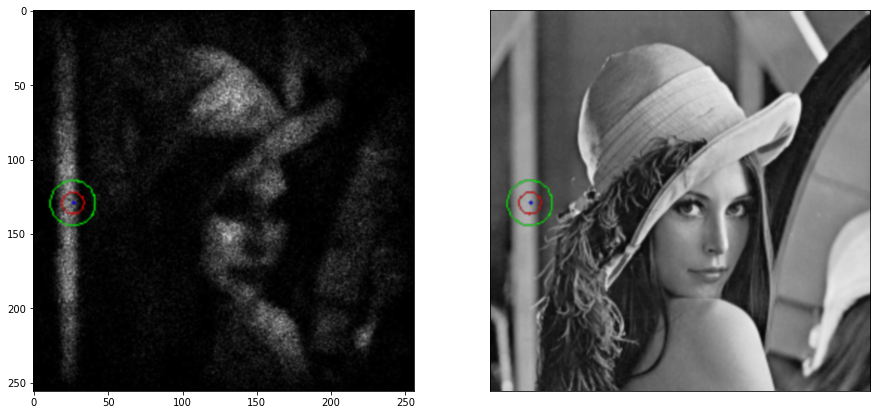

i: 120000
acceptance rate: 0.9048257931183907


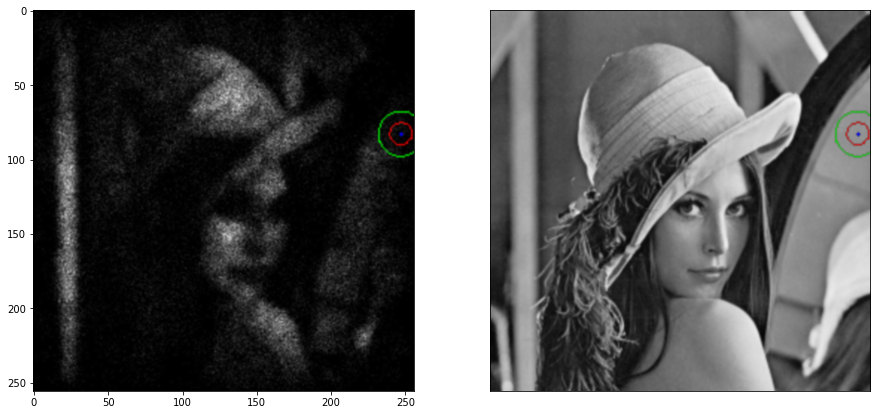

i: 121000
acceptance rate: 0.904678473731622


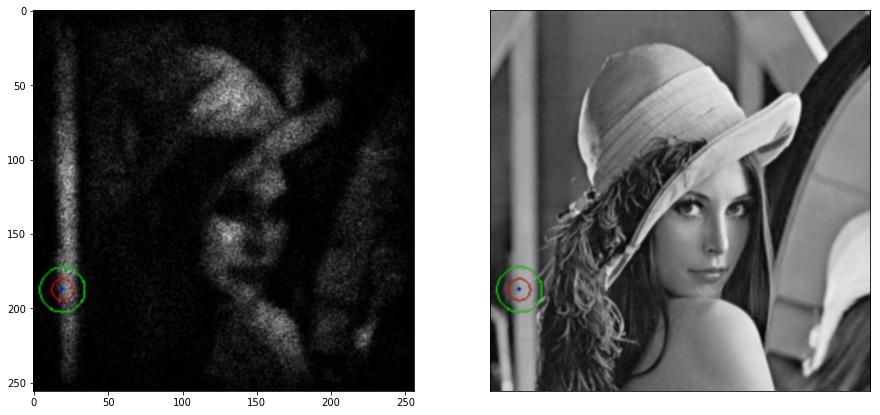

i: 122000
acceptance rate: 0.9044597995098401


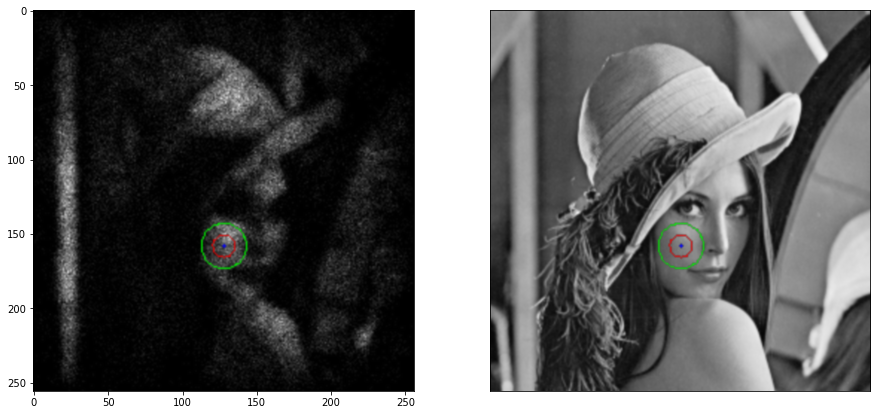

i: 123000
acceptance rate: 0.9042528109527564


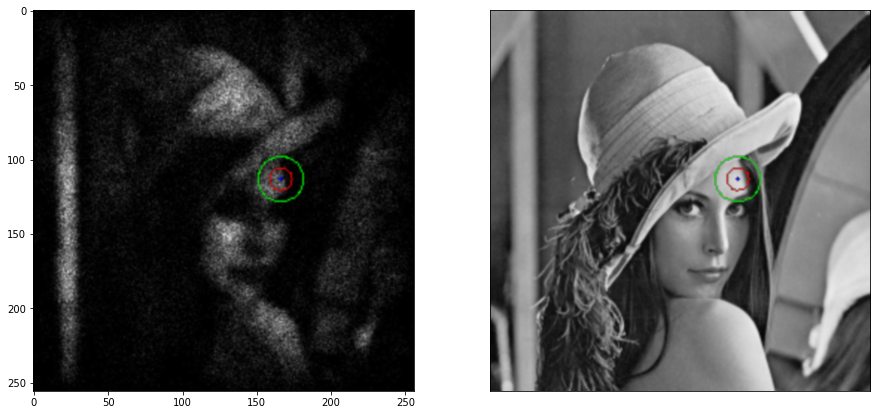

i: 124000
acceptance rate: 0.9041298054047952


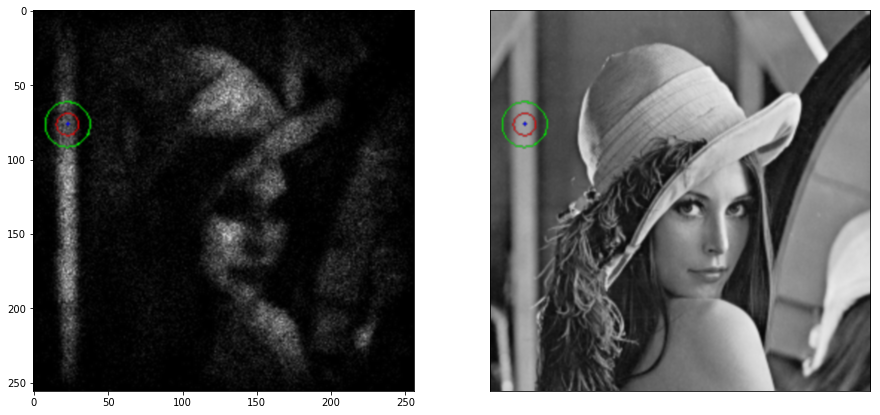

i: 125000
acceptance rate: 0.903984768121855


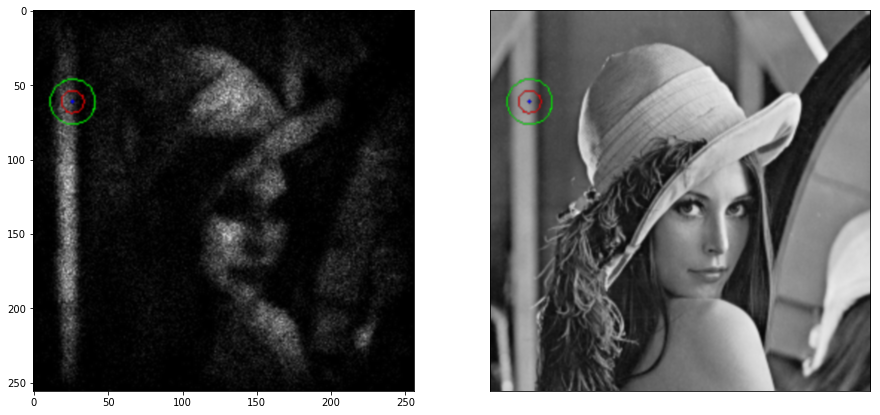

i: 126000
acceptance rate: 0.9037706049951985


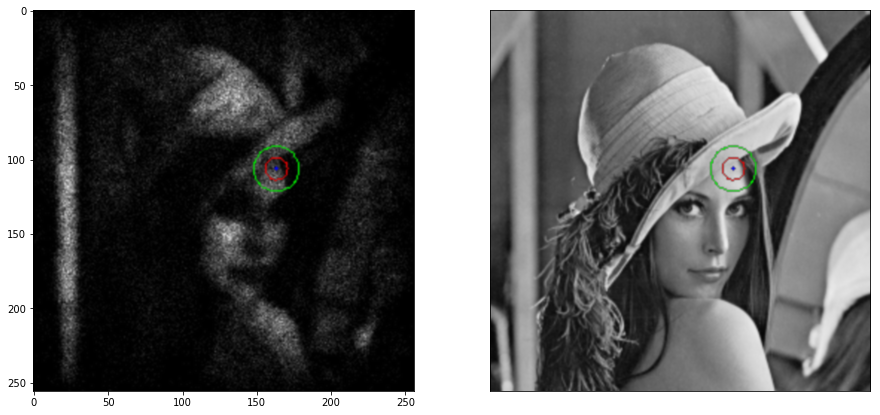

i: 127000
acceptance rate: 0.9040322517145535


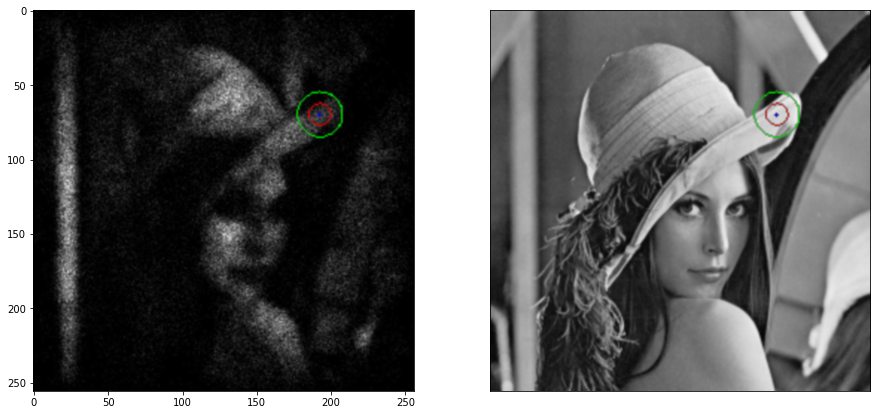

i: 128000
acceptance rate: 0.9040007499941407


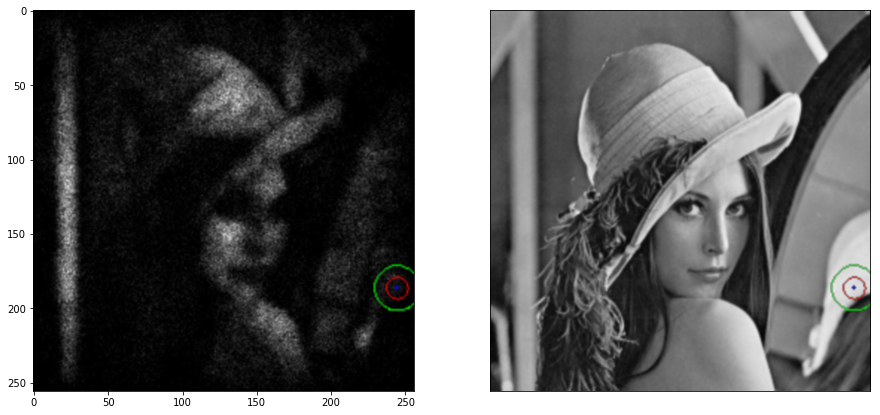

i: 129000
acceptance rate: 0.9040317516918474


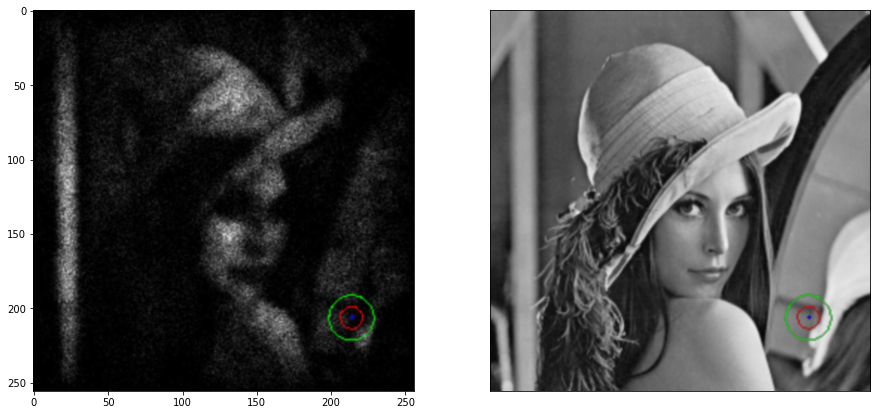

i: 130000
acceptance rate: 0.9041545834262813


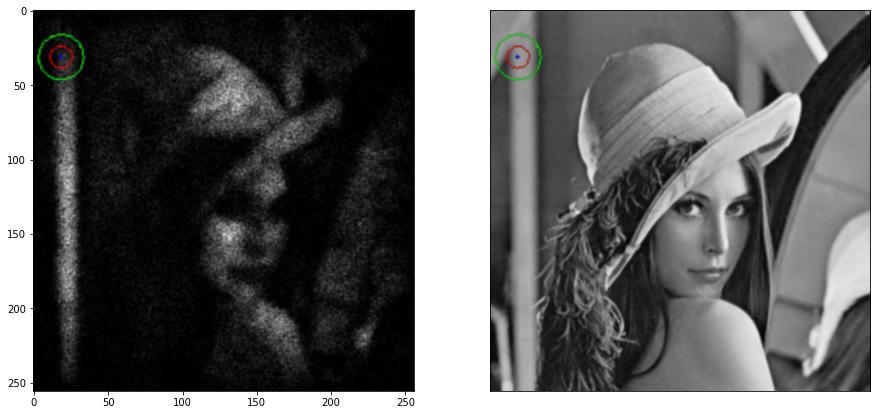

i: 131000
acceptance rate: 0.9038251616399875


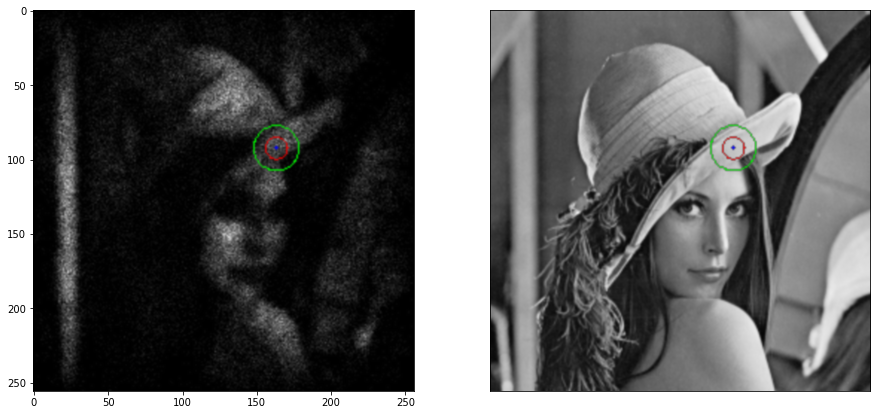

i: 132000
acceptance rate: 0.9038870917644564


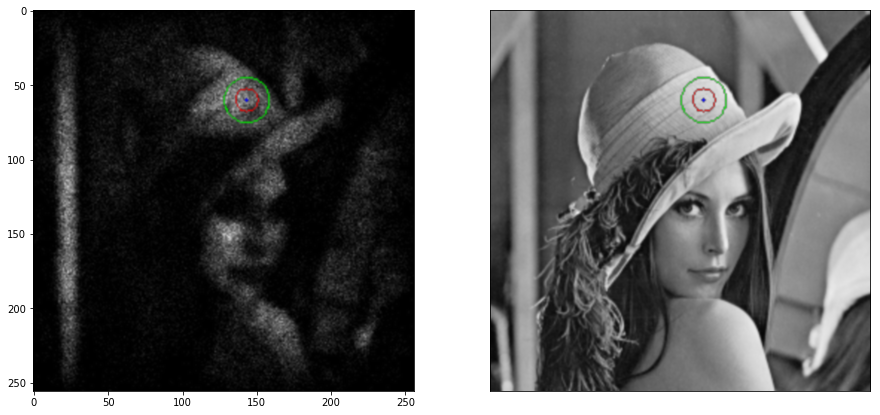

i: 133000
acceptance rate: 0.903872903211254


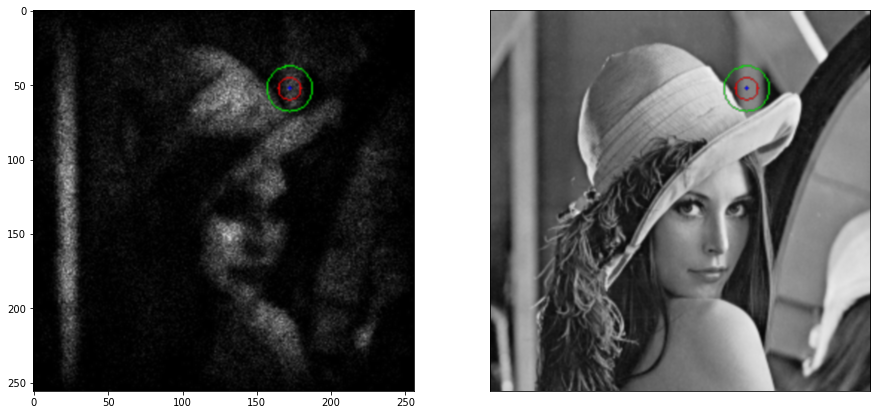

i: 134000
acceptance rate: 0.9037469869627839


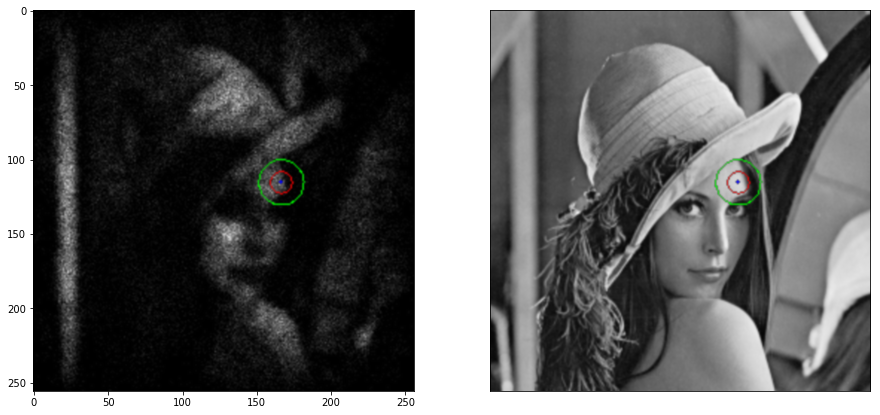

i: 135000
acceptance rate: 0.9039414522855386


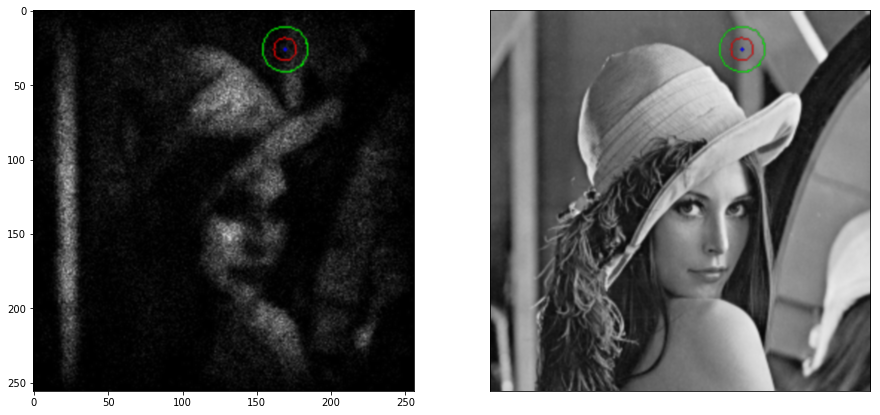

i: 136000
acceptance rate: 0.9041771751678297


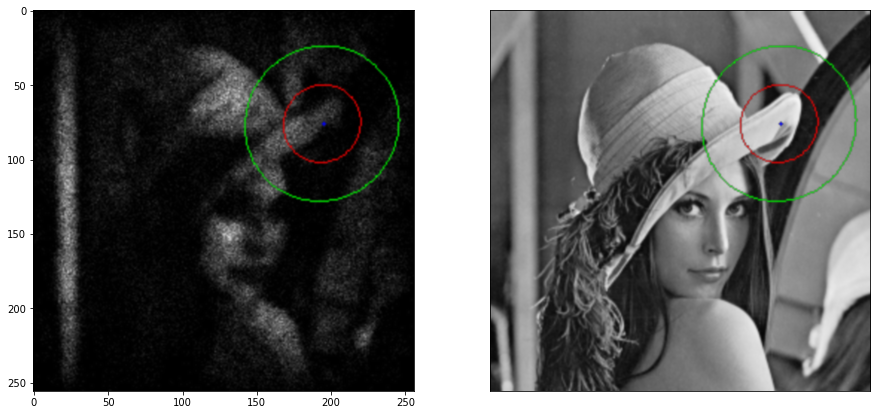

i: 137000
acceptance rate: 0.9043875592148962


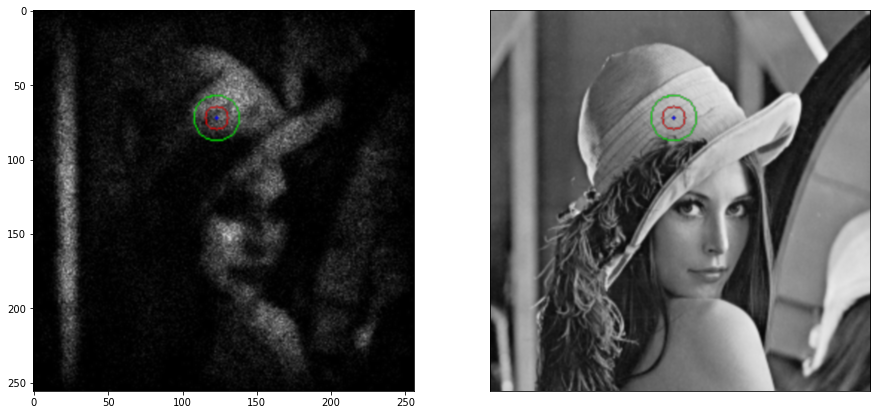

i: 138000
acceptance rate: 0.9042253317004949


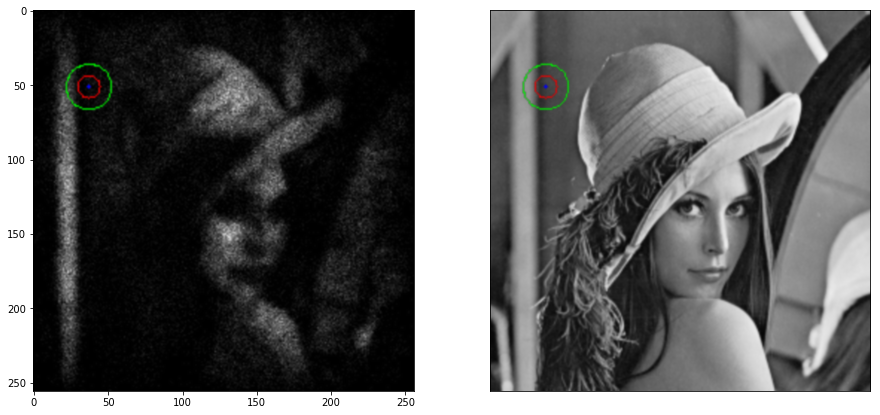

i: 139000
acceptance rate: 0.9043172351278048


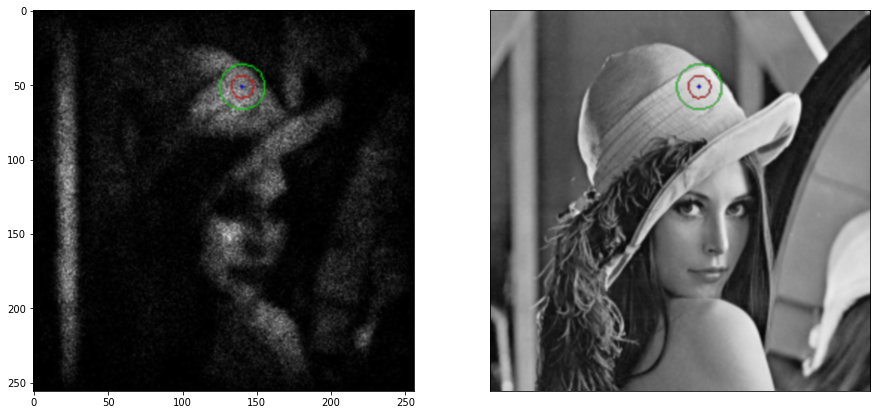

i: 140000
acceptance rate: 0.9043435404032828


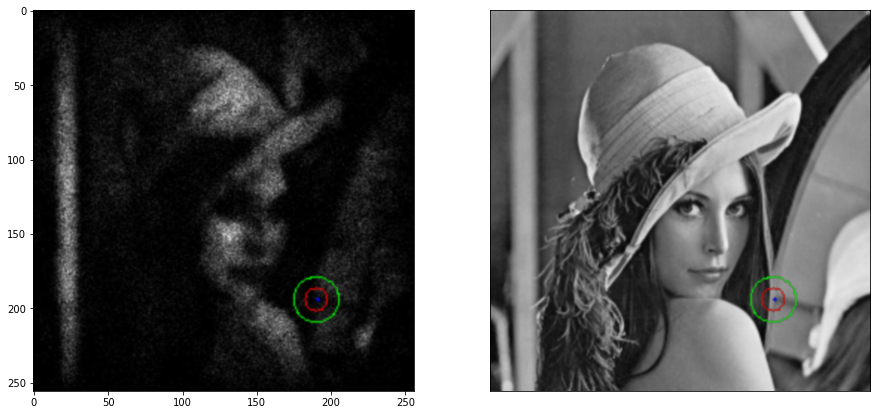

i: 141000
acceptance rate: 0.9044829469294544


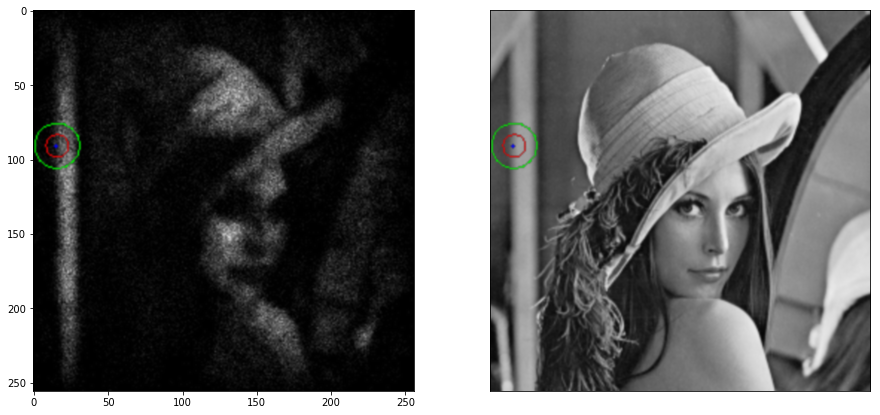

i: 142000
acceptance rate: 0.9043105330244153


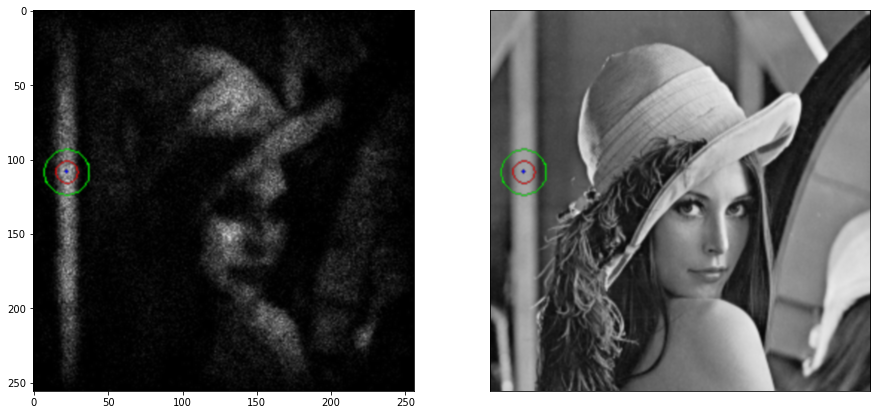

i: 143000
acceptance rate: 0.9040566149887064


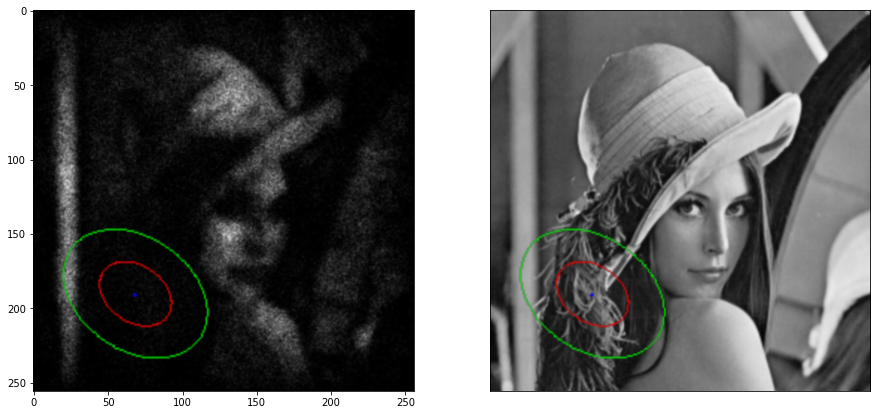

i: 144000
acceptance rate: 0.9040423330393539


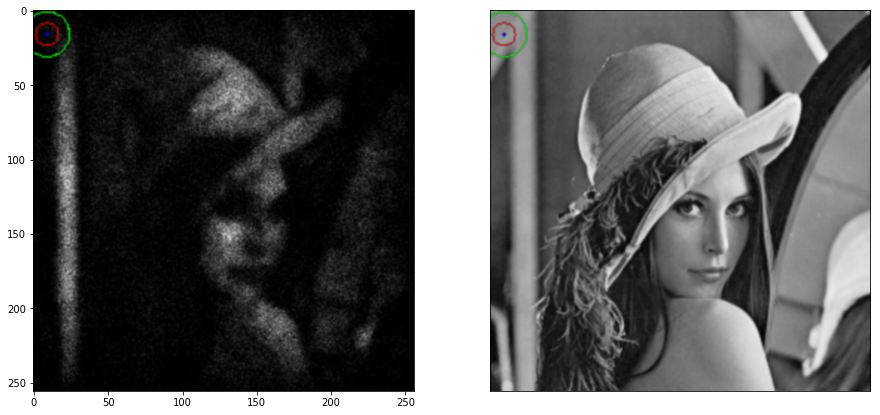

i: 145000
acceptance rate: 0.9039661795435894


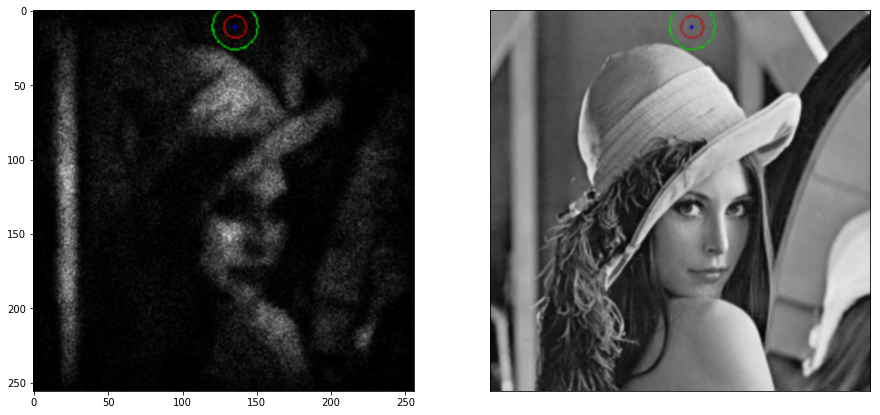

i: 146000
acceptance rate: 0.9040075067978987


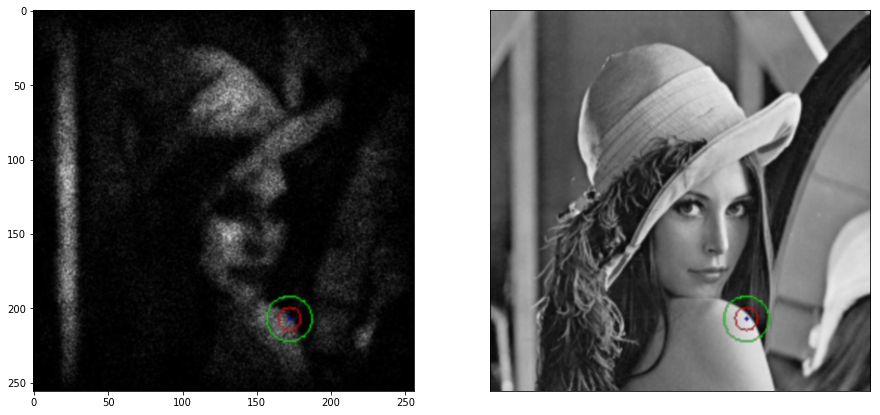

i: 147000
acceptance rate: 0.9038850075849825


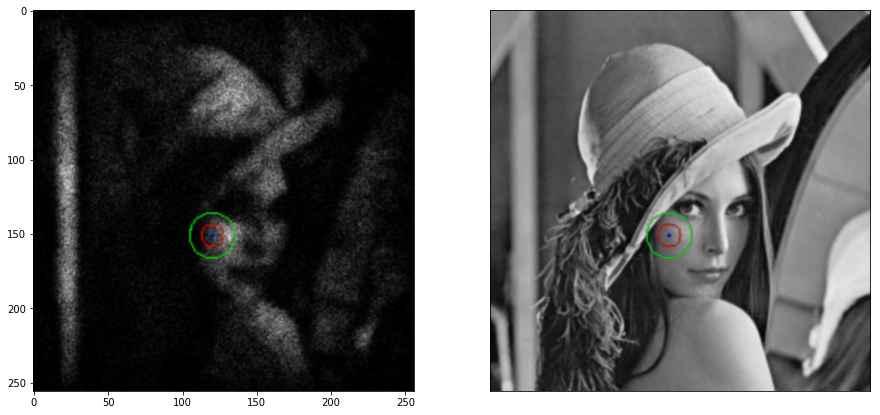

i: 148000
acceptance rate: 0.9038722711333032


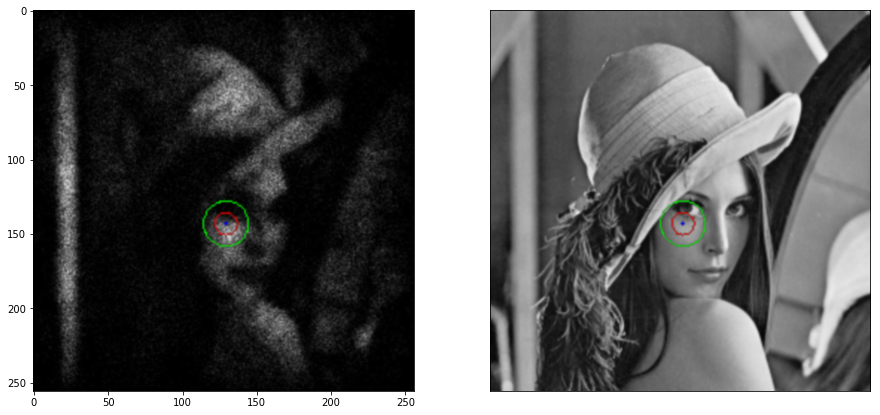

In [ ]:
makeHistogram(img_1)

In [ ]:
img_final = cv2.imread('MetropolisTest_Final.png',0)
print('img final max value: ' + repr(img_final.max()))
plt.imshow(img_final, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

In [ ]:
img_error = np.absolute(img - img_final)/img.max()
print('img error max value: ' + repr(img_error.max()))
plt.imshow(img_error, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()